<a href="https://colab.research.google.com/github/newgabo/DM_CyT_TP_1/blob/main/DMCyT_TP01_Grupo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Pre-Entrega TP1 - Data mining en Música

Materia: Data Mining en Ciencia y Tecnología

Año: 2020



Integrantes:
* Guadalupe Castaño
* Javier Gamboa
* Gabriel Cillo
* Laura Eliaschev


## Consignas

Utilizando la API de Spotify se descargó la información de 4092 pistas de audio. Cada registro tiene variables de features de alto (*audio_features*), bajo nivel (*audio_analysis*) y metadata de los tracks. La idea es limpiar los campos a utilizar y hacer un primer análisis de los datos.

Para facilitar los primeros pasos utilizar una pequeña porción aleatoria de los datos e ir aumentando progresivamente. Observación: los datos de *audio_analysis* pesan 1.3 GB

### Dataset *tracks* 

-   De los datos de *tracks*, separar las etiquetas que se podrán utilizar para la validación externa (Artista, Álbum, Año, Género), de los campos que no se utilizarán.

### Dataset *audio_features*

El dataset *audio_features* contiene atributos globales de alto nivel para cada pista de audio.

-   Con los datos de *audio_features*, generar un gráfico tipo *scatter matrix*.

-   Identificar variables más o menos informativas *a priori* y variables que requieran, además de la estandarización, alguna corrección para asimilar la distribución a una normal.

-   Estandarizar y volver a generar un gráfico tipo *scatter matrix*.

-   Identificar, si es que hay, valores extremos que sea necesario descartar.

### Dataset *audio_analysis*

El dataset *audio_analysis* contiene las variables continuas de bajo nivel, estimadas en ventanas temporales, como *timbre* o *pitches*. Como primer paso, deberán:

-   Resumir estas variables en valores por canción. Por ejemplo, tomar el promedio o el desvío estándar del timbre entre todas las ventanas, obteniendo 12 valores de timbre promedio y 12 valores de desvío estándar del timbre por canción.

-   Contruir un *data frame* con estos valores.

-   Generar un gráfico tipo *scatter matrix*.

-   Identificar variables más o menos informativas *a priori* y variables que requieran, además de la estandarización, alguna corrección para asimilar la distribución a una normal.

-   Estandarizar y volver a generar un gráfico tipo *scatter matrix*.

-   Identificar, si es que hay, valores extremos que sea necesario descartar.

# Pre-procesamiento

In [ ]:
# Instalaciones
!pip -q install spotipy
!pip -q install -U librosa seaborn
#!wget -q https://www.dropbox.com/s/nqjs076fidighaz/SopSax.NoVib.mf.C4B4.wav?dl=1 -O SopSax.NoVib.mf.C4B4.wav
!pip install feature_engine

In [ ]:
# Librerias
import matplotlib.pyplot as plt
import pandas as pd 
import spotipy 
import librosa
import librosa.display
import numpy as np
import matplotlib as mpl
import urllib.request
import seaborn as sns
import tqdm
import scipy
import joblib
from pathlib import Path
from IPython.display import Audio, Markdown, Image
from spotipy.oauth2 import SpotifyClientCredentials
from numpy import asarray
from feature_engine import variable_transformers as vt
import statsmodels.api as sm

# Números y Datos
import numpy as np
import pandas as pd
from scipy.spatial.distance import pdist, squareform
from scipy.interpolate import interp1d
from scipy import stats 

# Análisis de sonido
import librosa
import librosa.display
import spotipy 
from spotipy.oauth2 import SpotifyClientCredentials 

# Machine learning
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import quantile_transform
from sklearn.preprocessing import QuantileTransformer

## Obtenemos los archivos

In [ ]:
# Bajamos los archivos del Dropbox
!wget https://www.dropbox.com/s/ms6260jqmsmz5qu/audio_features.pickle?dl=1 -O audio_features.pickle
!wget https://www.dropbox.com/s/8d0y9bms80ly8ui/tracks.pickle?dl=1 -O tracks.pickle
!wget https://www.dropbox.com/s/1cmb8e8zvv6hsfs/audio_analysis.pickle?dl=1 -O audio_analysis.pickle

--2020-10-11 14:55:36--  https://www.dropbox.com/s/ms6260jqmsmz5qu/audio_features.pickle?dl=1
Resolving www.dropbox.com (www.dropbox.com)... 162.125.9.1, 2620:100:601f:1::a27d:901
Connecting to www.dropbox.com (www.dropbox.com)|162.125.9.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/dl/ms6260jqmsmz5qu/audio_features.pickle [following]
--2020-10-11 14:55:36--  https://www.dropbox.com/s/dl/ms6260jqmsmz5qu/audio_features.pickle
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc16829ed32feb021f3c580e6cb8.dl.dropboxusercontent.com/cd/0/get/BBExVa3Pq3Xae41Kh8ss8joYbmOe0dOxsEpu-27dYXApfvtPg3HNKne_Ezgc7AY0ZVQo9IBSNwCKvW2MaFmX_zOK1eOq9DJ2ip0YuvXVtnybc1ADIzmra537GS25Prh6UU4/file?dl=1# [following]
--2020-10-11 14:55:36--  https://uc16829ed32feb021f3c580e6cb8.dl.dropboxusercontent.com/cd/0/get/BBExVa3Pq3Xae41Kh8ss8joYbmOe0dOxsEpu-27dYXApfvtPg3HNKne_Ezgc7AY0ZVQo9IBSNwCKvW2MaFmX_

In [ ]:
# Levantamos los dataset a partir de los archivos
df_tracks = pd.read_pickle('tracks.pickle')
df_af = pd.read_pickle('audio_features.pickle')
df_aa = pd.read_pickle('audio_analysis.pickle')

## Exploramos el contenido de los 3 datasets

In [ ]:
df_tracks.head()

,album,artists,available_markets,disc_number,duration_ms,explicit,external_ids,external_urls,href,is_local,name,popularity,preview_url,track_number,type,uri,genre
id,,,,,,,,,,,,,,,,,
4d3XHYFFuYYzxWr2cJ6yQl,"{'album_type': 'ALBUM', 'artists': [{'external...",Tommy Flanagan,"[AD, AE, AL, AR, AT, AU, BA, BE, BG, BH, BO, B...",1,349600,False,{'isrc': 'USEWJ0702033'},{'spotify': 'https://open.spotify.com/track/4d...,https://api.spotify.com/v1/tracks/4d3XHYFFuYYz...,False,Angel Eyes - Studio,49,https://p.scdn.co/mp3-preview/10e213fc96d2f614...,3,track,spotify:track:4d3XHYFFuYYzxWr2cJ6yQl,jazz
3X3p3u03P8eFL8WTH0oaaU,"{'album_type': 'ALBUM', 'artists': [{'external...",Art Farmer,"[AD, AE, AL, AR, AT, AU, BA, BE, BG, BH, BO, B...",1,344066,False,{'isrc': 'USBN29100147'},{'spotify': 'https://open.spotify.com/track/3X...,https://api.spotify.com/v1/tracks/3X3p3u03P8eF...,False,Fair Weather - Remastered,47,None,2,track,spotify:track:3X3p3u03P8eFL8WTH0oaaU,jazz
4KlXeaheot0OI9PoOWspvZ,"{'album_type': 'ALBUM', 'artists': [{'external...",Christian Scott aTunde Adjuah,"[CA, US]",1,348746,False,{'isrc': 'USC4R0714598'},{'spotify': 'https://open.spotify.com/track/4K...,https://api.spotify.com/v1/tracks/4KlXeaheot0O...,False,Cease Fire,13,None,5,track,spotify:track:4KlXeaheot0OI9PoOWspvZ,jazz
3j76McoUI18gDoqxYE14Bu,"{'album_type': 'ALBUM', 'artists': [{'external...",Skalpel,"[AD, AE, AL, AR, AT, AU, BA, BE, BG, BH, BO, B...",1,275935,False,{'isrc': 'PLK281400008'},{'spotify': 'https://open.spotify.com/track/3j...,https://api.spotify.com/v1/tracks/3j76McoUI18g...,False,Sea,25,https://p.scdn.co/mp3-preview/d154ecaf7df8206c...,8,track,spotify:track:3j76McoUI18gDoqxYE14Bu,jazz
4zxd4tiXPlWMqoJltbVTbE,"{'album_type': 'ALBUM', 'artists': [{'external...",Miles Davis,"[AD, AE, AL, AR, AT, AU, BA, BE, BG, BH, BO, B...",2,284560,False,{'isrc': 'USSM15800962'},{'spotify': 'https://open.spotify.com/track/4z...,https://api.spotify.com/v1/tracks/4zxd4tiXPlWM...,False,Stella By Starlight,56,https://p.scdn.co/mp3-preview/a4430030bca4c02c...,3,track,spotify:track:4zxd4tiXPlWMqoJltbVTbE,jazz


In [ ]:
df_tracks.describe()

,disc_number,duration_ms,popularity,track_number
count,4092.000000,4.092000e+03,4092.000000,4092.000000
mean,1.089932,2.904784e+05,18.982649,6.041544
std,0.868654,1.629239e+05,20.722773,5.957745
min,1.000000,3.070600e+04,0.000000,1.000000
25%,1.000000,1.961705e+05,0.000000,2.000000
50%,1.000000,2.562740e+05,14.000000,4.000000
75%,1.000000,3.415765e+05,33.000000,9.000000
max,50.000000,3.650800e+06,86.000000,74.000000


In [ ]:
df_af.head()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,uri,track_href,analysis_url,duration_ms,time_signature
id,,,,,,,,,,,,,,,,,
6avAsaa2IsXHT2mtQ6cGVe,0.6040,0.9630,7,-4.622,1,0.1250,0.00284,0.846000,0.0769,0.2750,172.020,audio_features,spotify:track:6avAsaa2IsXHT2mtQ6cGVe,https://api.spotify.com/v1/tracks/6avAsaa2IsXH...,https://api.spotify.com/v1/audio-analysis/6avA...,388663,4
6fvu2d6gHAdiNCMco4lTxK,0.0677,0.0581,2,-25.662,0,0.0402,0.99400,0.567000,0.1170,0.0372,73.509,audio_features,spotify:track:6fvu2d6gHAdiNCMco4lTxK,https://api.spotify.com/v1/tracks/6fvu2d6gHAdi...,https://api.spotify.com/v1/audio-analysis/6fvu...,283653,3
5GmrXcVIMgLaaqKVxhi5kp,0.2590,0.2420,2,-15.790,1,0.0401,0.53000,0.000003,0.0714,0.3050,178.132,audio_features,spotify:track:5GmrXcVIMgLaaqKVxhi5kp,https://api.spotify.com/v1/tracks/5GmrXcVIMgLa...,https://api.spotify.com/v1/audio-analysis/5Gmr...,213640,3
1DMIHggF47tqsO468VUDmd,0.2420,0.4450,4,-7.421,0,0.0318,0.49400,0.000224,0.1860,0.0867,86.289,audio_features,spotify:track:1DMIHggF47tqsO468VUDmd,https://api.spotify.com/v1/tracks/1DMIHggF47tq...,https://api.spotify.com/v1/audio-analysis/1DMI...,247933,4
78Ovt1QkZbU1QBMKWpcXPy,0.7010,0.8060,9,-5.508,1,0.1480,0.18300,0.003750,0.1230,0.9750,147.150,audio_features,spotify:track:78Ovt1QkZbU1QBMKWpcXPy,https://api.spotify.com/v1/tracks/78Ovt1QkZbU1...,https://api.spotify.com/v1/audio-analysis/78Ov...,168112,4


In [ ]:
df_af.describe()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4.270000e+03,4270.000000
mean,0.441164,0.553732,5.197424,-11.673730,0.640749,0.066976,0.412173,0.387020,0.191843,0.342541,122.126375,2.906830e+05,3.846838
std,0.185640,0.339423,3.537060,7.493501,0.479837,0.056458,0.418159,0.390515,0.166345,0.270482,33.218382,1.617286e+05,0.536735
min,0.000000,0.000581,0.000000,-45.393000,0.000000,0.000000,0.000000,0.000000,0.018500,0.000000,0.000000,3.070700e+04,0.000000
25%,0.296000,0.222000,2.000000,-16.021250,0.000000,0.038000,0.001860,0.000793,0.093500,0.108000,94.401000,1.968935e+05,4.000000
50%,0.450000,0.583500,5.000000,-9.482500,1.000000,0.046800,0.214000,0.226000,0.121000,0.273000,124.022500,2.574265e+05,4.000000
75%,0.580000,0.897000,8.000000,-5.838250,1.000000,0.070400,0.901750,0.835000,0.235000,0.534750,140.756750,3.421465e+05,4.000000
max,0.946000,0.998000,11.000000,0.326000,1.000000,0.857000,0.996000,0.990000,0.987000,0.985000,214.744000,3.650800e+06,5.000000


In [ ]:
df_aa.head()

,start,duration,confidence,loudness_start,loudness_max_time,loudness_max,loudness_end,pitches,timbre,id
0,0.00000,0.33061,0.000,-15.742,0.01269,-12.896,0.0,"[0.102, 0.103, 0.112, 0.21, 1.0, 0.068, 0.045,...","[43.022, 16.787, -40.89, 11.82, 105.068, -67.1...",6avAsaa2IsXHT2mtQ6cGVe
1,0.33061,0.36481,0.159,-22.482,0.08965,-18.792,0.0,"[0.008, 0.022, 0.029, 0.191, 1.0, 0.078, 0.013...","[38.644, -65.426, -9.06, -7.153, 135.949, -47....",6avAsaa2IsXHT2mtQ6cGVe
2,0.69542,0.53002,1.000,-23.472,0.00965,-7.144,0.0,"[0.037, 0.047, 0.063, 0.307, 1.0, 0.149, 0.06,...","[47.643, 50.817, 75.922, 53.108, 25.988, -42.0...",6avAsaa2IsXHT2mtQ6cGVe
3,1.22544,0.44059,0.626,-19.710,0.00809,-10.394,0.0,"[0.045, 0.067, 0.048, 0.131, 0.464, 0.104, 0.0...","[44.839, -20.55, 58.387, 38.347, 47.279, -59.7...",6avAsaa2IsXHT2mtQ6cGVe
4,1.66603,0.26816,0.082,-21.887,0.11164,-18.096,0.0,"[0.022, 0.045, 0.036, 0.149, 0.695, 0.147, 0.0...","[40.058, -29.617, 61.054, -12.254, 110.751, -4...",6avAsaa2IsXHT2mtQ6cGVe


In [ ]:
df_aa.describe()

,start,duration,confidence,loudness_start,loudness_max_time,loudness_max,loudness_end
count,4.504350e+06,4.504350e+06,4.504350e+06,4.504350e+06,4.504350e+06,4.504350e+06,4.504350e+06
mean,1.858137e+02,2.691886e-01,4.865786e-01,-2.020962e+01,5.859114e-02,-1.287742e+01,-5.309456e-02
std,1.952177e+02,2.868102e-01,2.916497e-01,1.046268e+01,7.397216e-02,1.029678e+01,1.761196e+00
min,0.000000e+00,6.000000e-02,0.000000e+00,-6.000000e+01,-5.800000e-03,-6.000000e+01,-6.000000e+01
25%,7.213270e+01,1.560500e-01,2.400000e-01,-2.679900e+01,1.995000e-02,-1.847600e+01,0.000000e+00
50%,1.453396e+02,2.174100e-01,4.610000e-01,-1.818400e+01,4.081000e-02,-9.859000e+00,0.000000e+00
75%,2.432711e+02,3.192300e-01,7.180000e-01,-1.194000e+01,7.283000e-02,-5.072000e+00,0.000000e+00
max,3.642572e+03,2.391782e+02,1.000000e+00,1.862000e+00,1.969488e+01,5.133000e+00,0.000000e+00


## Graficamos por Género y Artista

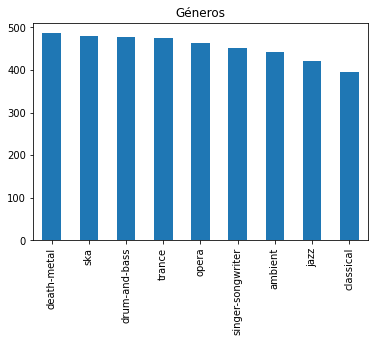

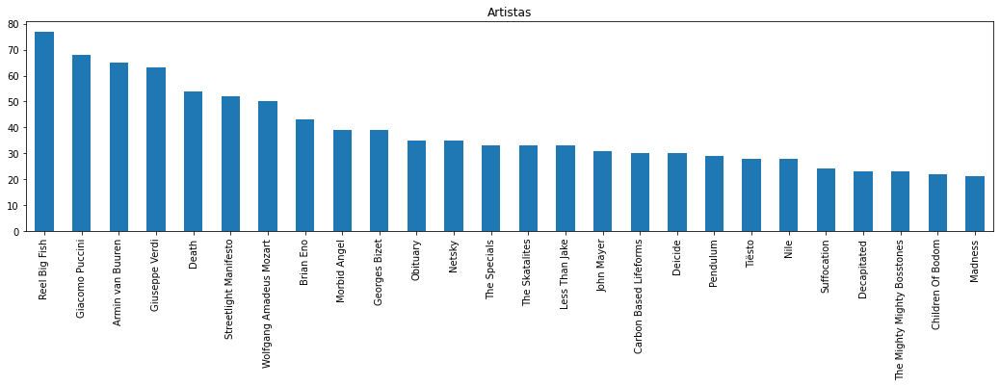

In [ ]:
df_tracks['genre'].value_counts().plot.bar(figsize=(6,4));
plt.title('Géneros')
plt.show()
df_tracks['artists'].value_counts()[:26].plot.bar(figsize=(18,4));
plt.title('Artistas');

# Dataset *tracks*
De los datos de tracks, separamos las etiquetas Artista, Álbum, Año, Género.
Obtenemos el año en función de mapear el release_date que está dentro del campo "album"


In [ ]:
# Procesamos el campo release_date para llegar el Año
df_tracks['release_date'] = df_tracks['album'].map(lambda x: x['release_date'])
df_tracks['release_date']

id
4d3XHYFFuYYzxWr2cJ6yQl          1991
3X3p3u03P8eFL8WTH0oaaU          1958
4KlXeaheot0OI9PoOWspvZ    2014-01-01
3j76McoUI18gDoqxYE14Bu    2014-11-10
4zxd4tiXPlWMqoJltbVTbE    1959-08-17
                             ...    
5vSsQH8wH68PDKJbNfxzpc    2011-03-21
7xYKAlU77jAAnAixQ5IgSn    2012-07-20
4hXEgyy5nNgdiBvJcJ9o8u    2009-02-23
4HpSbJgNpoOphIeCK3z9sk    2008-08-25
30KzbX1viF0aTL1NS5coDY    2010-07-19
Name: release_date, Length: 4092, dtype: object

In [ ]:
# Como tenemos formatos de fechas mixtos tenemos que extraer el año según cada caso
def date_formator(date):
    if '-' in date:
        year = pd.to_datetime(date, format = '%Y-%m-%d').year
        return int(year)
    elif int(date)>0:
        year = pd.to_datetime(date, format = '%Y').year
        return int(year)
    return None
       
df_tracks['release_date'] = df_tracks['release_date'].apply(date_formator)
df_tracks['release_date']

id
4d3XHYFFuYYzxWr2cJ6yQl    1991.0
3X3p3u03P8eFL8WTH0oaaU    1958.0
4KlXeaheot0OI9PoOWspvZ    2014.0
3j76McoUI18gDoqxYE14Bu    2014.0
4zxd4tiXPlWMqoJltbVTbE    1959.0
                           ...  
5vSsQH8wH68PDKJbNfxzpc    2011.0
7xYKAlU77jAAnAixQ5IgSn    2012.0
4hXEgyy5nNgdiBvJcJ9o8u    2009.0
4HpSbJgNpoOphIeCK3z9sk    2008.0
30KzbX1viF0aTL1NS5coDY    2010.0
Name: release_date, Length: 4092, dtype: float64

In [ ]:
# Extraemos los datos Artista, Álbum, Año, Género del Dataset Tracks
df_tracks_01 = df_tracks[['album','artists', 'release_date', 'genre']]
df_tracks_01

,album,artists,release_date,genre
id,,,,
4d3XHYFFuYYzxWr2cJ6yQl,"{'album_type': 'ALBUM', 'artists': [{'external...",Tommy Flanagan,1991.0,jazz
3X3p3u03P8eFL8WTH0oaaU,"{'album_type': 'ALBUM', 'artists': [{'external...",Art Farmer,1958.0,jazz
4KlXeaheot0OI9PoOWspvZ,"{'album_type': 'ALBUM', 'artists': [{'external...",Christian Scott aTunde Adjuah,2014.0,jazz
3j76McoUI18gDoqxYE14Bu,"{'album_type': 'ALBUM', 'artists': [{'external...",Skalpel,2014.0,jazz
4zxd4tiXPlWMqoJltbVTbE,"{'album_type': 'ALBUM', 'artists': [{'external...",Miles Davis,1959.0,jazz
...,...,...,...,...
5vSsQH8wH68PDKJbNfxzpc,"{'album_type': 'ALBUM', 'artists': [{'external...",Arctic Moon,2011.0,trance
7xYKAlU77jAAnAixQ5IgSn,"{'album_type': 'ALBUM', 'artists': [{'external...",Solarstone,2012.0,trance
4hXEgyy5nNgdiBvJcJ9o8u,"{'album_type': 'ALBUM', 'artists': [{'external...",Richard Durand,2009.0,trance


In [ ]:
# Obtenemos el tipo de album y el nombre de la variable album
album = df_tracks_01['album'].apply(pd.Series)
album = album[['album_type','name']]

df_tracks_01 = pd.concat([df_tracks_01,album], axis=1).reset_index(drop=True)
df_tracks_01

,album,artists,release_date,genre,album_type,name
0,"{'album_type': 'ALBUM', 'artists': [{'external...",Tommy Flanagan,1991.0,jazz,ALBUM,Master Trio
1,"{'album_type': 'ALBUM', 'artists': [{'external...",Art Farmer,1958.0,jazz,ALBUM,Modern Art
2,"{'album_type': 'ALBUM', 'artists': [{'external...",Christian Scott aTunde Adjuah,2014.0,jazz,ALBUM,Christian Scott Collection
3,"{'album_type': 'ALBUM', 'artists': [{'external...",Skalpel,2014.0,jazz,ALBUM,Transit
4,"{'album_type': 'ALBUM', 'artists': [{'external...",Miles Davis,1959.0,jazz,ALBUM,Kind Of Blue (Legacy Edition)
...,...,...,...,...,...,...
4087,"{'album_type': 'ALBUM', 'artists': [{'external...",Arctic Moon,2011.0,trance,ALBUM,Adelaide
4088,"{'album_type': 'ALBUM', 'artists': [{'external...",Solarstone,2012.0,trance,ALBUM,Summer Trance Top 50 - 2012
4089,"{'album_type': 'ALBUM', 'artists': [{'external...",Richard Durand,2009.0,trance,ALBUM,Into Something
4090,"{'album_type': 'ALBUM', 'artists': [{'external...",Chicane,2008.0,trance,ALBUM,Bruised Water


# Dataset *audio_features*

Analizamos la infomación del dataset, realizamos estandarizaciones y normalizaciones a los datos y nos quedamos con las que nos brindan mejor información.

In [ ]:
#Nos quedamos con las columnas numéricas para hacer el Scatter
X_features = df_af[['danceability','energy','loudness','speechiness','acousticness','instrumentalness','valence','tempo','liveness','key','mode','time_signature']]
X_features.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,valence,tempo,liveness,key,mode,time_signature
id,,,,,,,,,,,,
6avAsaa2IsXHT2mtQ6cGVe,0.6040,0.9630,-4.622,0.1250,0.00284,0.846000,0.2750,172.020,0.0769,7,1,4
6fvu2d6gHAdiNCMco4lTxK,0.0677,0.0581,-25.662,0.0402,0.99400,0.567000,0.0372,73.509,0.1170,2,0,3
5GmrXcVIMgLaaqKVxhi5kp,0.2590,0.2420,-15.790,0.0401,0.53000,0.000003,0.3050,178.132,0.0714,2,1,3
1DMIHggF47tqsO468VUDmd,0.2420,0.4450,-7.421,0.0318,0.49400,0.000224,0.0867,86.289,0.1860,4,0,4
78Ovt1QkZbU1QBMKWpcXPy,0.7010,0.8060,-5.508,0.1480,0.18300,0.003750,0.9750,147.150,0.1230,9,1,4


## ScaterMatrix

Realizamos un ScatterMatrix para las variables Numéricas del dataset audio_features

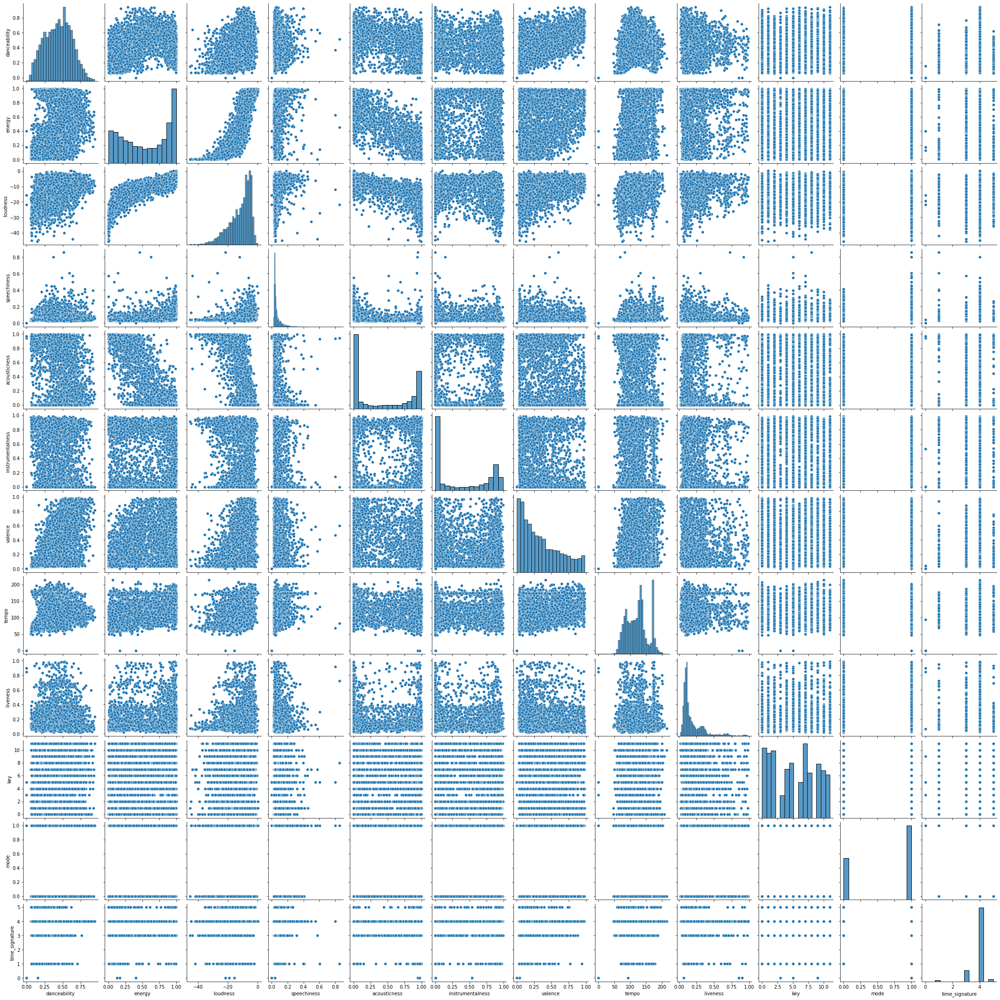

In [ ]:
#visualizar las features
sns.pairplot(X_features)

## Histogramas de datos Originales
Realizamos los histogramas del dataset audio_features originales para visualizar su distribución.

In [ ]:
# Hacemos histogramas por variables

# Definimos una funcion para hacer varios Histogramas
def draw_histograms(df, variables, n_rows, n_cols):
    fig=plt.figure(figsize=(12,12))
    for i, var_name in enumerate(variables):
        ax=fig.add_subplot(n_rows,n_cols,i+1)
        df[var_name].hist(bins=50,ax=ax, color='mediumpurple')
        ax.set_title(var_name)
    fig.tight_layout()  # Improves appearance a bit.
    plt.show()

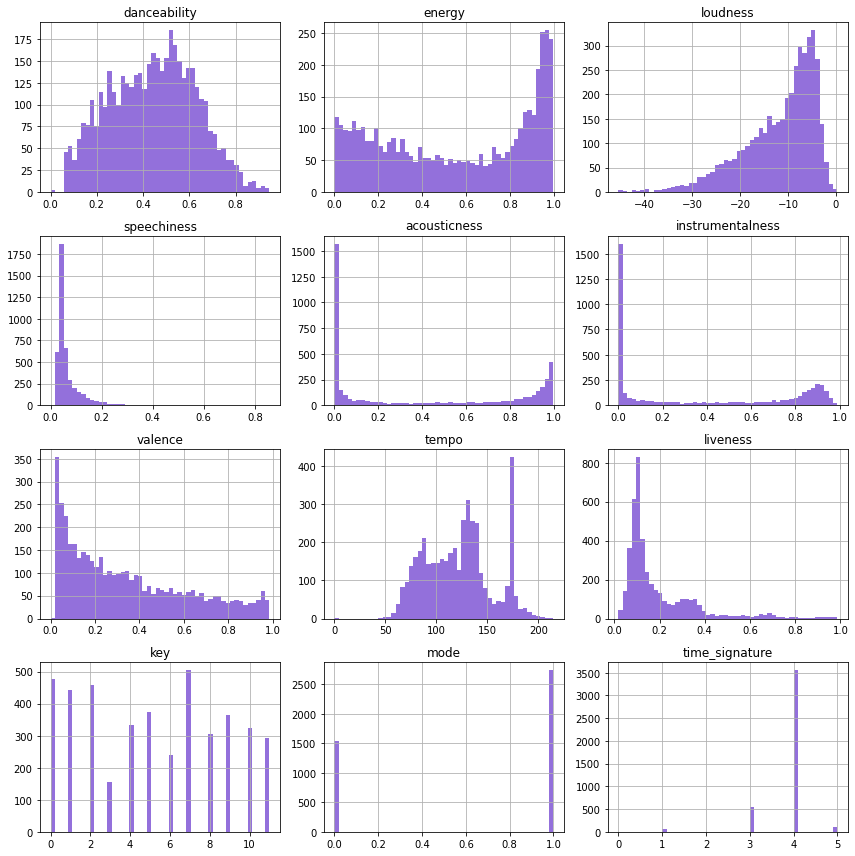

In [ ]:
# Aplicamos la funcion en el dataset de variables continuas

draw_histograms(X_features, X_features.columns, 4, 3)

Analizamos de las variables lo siguiente:
- Danceability: Numérica Continua con poco sesgo. 
- Energy: Numérica Continua con distribución tipo U.
- Loudness: Numérica Continua con sesgo a izquierda.
- Speechiness: Numérica Continua con sesgo a derecha.
- Acousticness: Numérica Continua con distribución tipo U.
- Instrumentalness: Numérica Continua con distribución tipo U.
- Valence: Numérica Continua con sesgo a derecha.
- Tempo: Numérica Continua con poco sesgo.
- Liveness: Numérica Continua con Sesgo a derecha.
- Key: Numérica Discreta; distribución uniforme.
- Mode: Variable Binaria.
- Time Signature: Numérica Discreta; distribución sesgada a izquierda.

## Estandarización de Variables
Procedemos a realizar la estandarización de las variables numéricas. Se prueban los métodos de estandarización por media y sd (StandardScaler) y la estandarización Min-Max.

### Estandarización Mean-SD

In [ ]:
# normalización por estandarización x = (x-media)/devío

# define standard scaler
SS = StandardScaler()
# transform data
X_features_norm1 = SS.fit_transform(X_features)
X_features_norm1 = pd.DataFrame(X_features_norm1)
X_features_norm1.describe()

,0,1,2,3,4,5,6,7,8,9,10,11
count,4.270000e+03,4.270000e+03,4.270000e+03,4.270000e+03,4.270000e+03,4.270000e+03,4.270000e+03,4.270000e+03,4.270000e+03,4.270000e+03,4.270000e+03,4.270000e+03
mean,-2.927661e-17,1.309257e-16,-8.407274e-17,4.321940e-17,3.198066e-17,-5.101306e-17,-3.151265e-17,-7.138448e-17,-1.798977e-16,1.492626e-16,3.969242e-16,1.763877e-16
std,1.000117e+00,1.000117e+00,1.000117e+00,1.000117e+00,1.000117e+00,1.000117e+00,1.000117e+00,1.000117e+00,1.000117e+00,1.000117e+00,1.000117e+00,1.000117e+00
min,-2.376730e+00,-1.629870e+00,-4.500329e+00,-1.186445e+00,-9.857988e-01,-9.911657e-01,-1.266555e+00,-3.676900e+00,-1.042194e+00,-1.469591e+00,-1.335505e+00,-7.167949e+00
25%,-7.820575e-01,-9.774549e-01,-5.802400e-01,-5.132996e-01,-9.813503e-01,-9.891361e-01,-8.672214e-01,-8.347373e-01,-5.912701e-01,-9.040838e-01,-1.335505e+00,2.853914e-01
50%,4.760310e-02,8.771154e-02,2.924516e-01,-3.574132e-01,-4.739723e-01,-4.123748e-01,-2.571288e-01,5.708729e-02,-4.259315e-01,-5.582236e-02,7.487807e-01,2.853914e-01
75%,7.479659e-01,1.011445e+00,7.788299e-01,6.064577e-02,1.170928e+00,1.147287e+00,7.107001e-01,5.609110e-01,2.594721e-01,7.924391e-01,7.487807e-01,2.853914e-01
max,2.719757e+00,1.309043e+00,1.601539e+00,1.399476e+01,1.396347e+00,1.544246e+00,2.375514e+00,2.788470e+00,4.780731e+00,1.640700e+00,7.487807e-01,2.148727e+00


Visualizamos los Histogramas de las variables estandarizadas por este método.

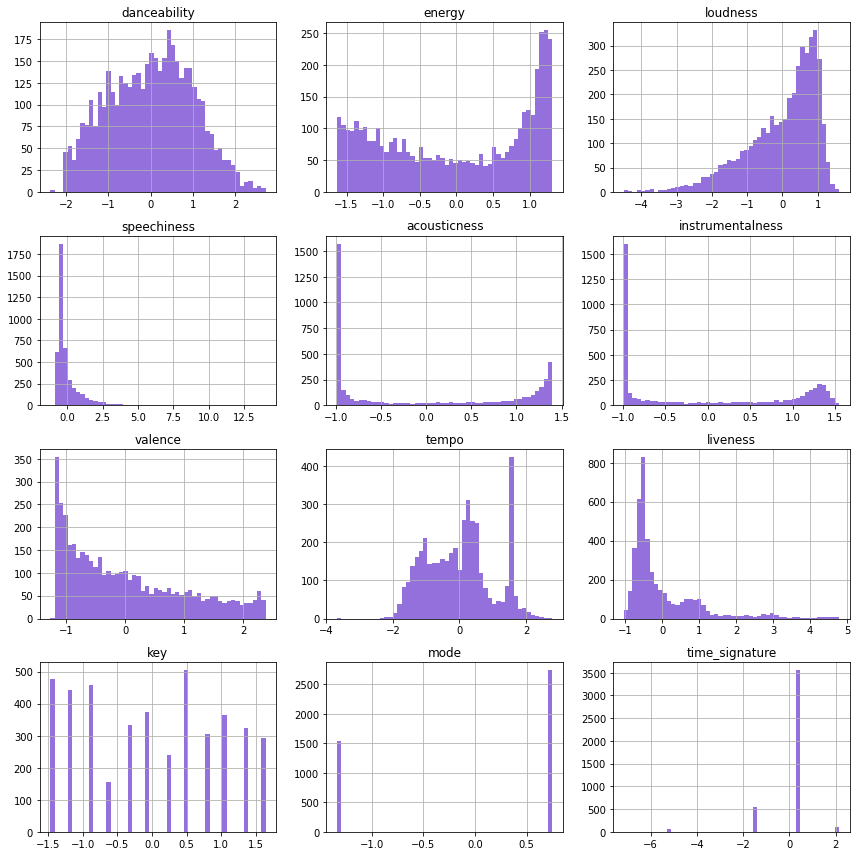

In [ ]:
# Vemos como quedan los Histogramas

# Renombro las columnas
X_features_norm1.columns = ['danceability','energy','loudness','speechiness','acousticness','instrumentalness','valence','tempo','liveness','key','mode','time_signature']
X_features_norm1.columns

# Aplicamos la funcion en el dataset de variables continuas
draw_histograms(X_features_norm1, X_features_norm1.columns, 4, 3)

### Estandarización Min-Max

In [ ]:
# normalizacion por min-max
# define min max scaler
MMS = MinMaxScaler()
# transform data
X_features_norm2 = MMS.fit_transform(X_features)
X_features_norm2 = pd.DataFrame(X_features_norm2)
X_features_norm2.describe()

,0,1,2,3,4,5,6,7,8,9,10,11
count,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000
mean,0.466347,0.554583,0.737533,0.078152,0.413828,0.390929,0.347757,0.568707,0.178981,0.472493,0.640749,0.769368
std,0.196237,0.340302,0.163903,0.065879,0.419839,0.394460,0.274601,0.154688,0.171755,0.321551,0.479837,0.107347
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.312896,0.221992,0.642441,0.044341,0.001867,0.000801,0.109645,0.439598,0.077439,0.181818,0.000000,0.800000
50%,0.475687,0.584427,0.785461,0.054609,0.214859,0.228283,0.277157,0.577537,0.105834,0.454545,1.000000,0.800000
75%,0.613108,0.898739,0.865171,0.082147,0.905371,0.843434,0.542893,0.655463,0.223542,0.727273,1.000000,0.800000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


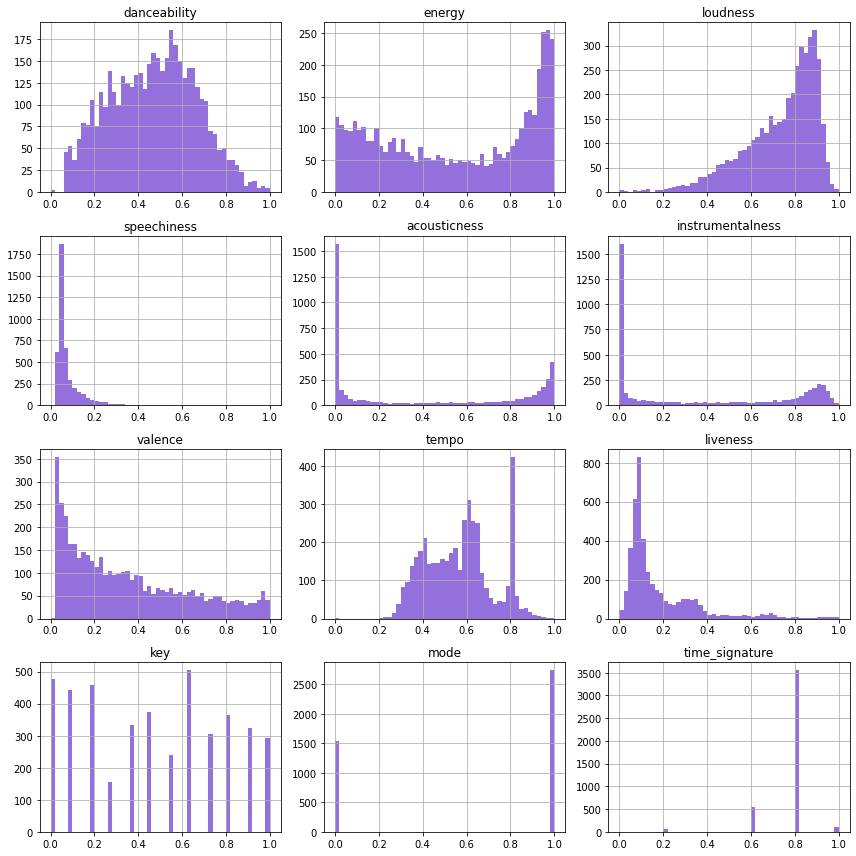

In [ ]:
# Vemos como quedan los Histogramas

# Renombro las columnas
X_features_norm2.columns = ['danceability','energy','loudness','speechiness','acousticness','instrumentalness','valence','tempo','liveness','key','mode','time_signature']
X_features_norm2.columns

# Aplicamos la funcion en el dataset de variables continuas
draw_histograms(X_features_norm2, X_features_norm2.columns, 4, 3)

Vemos que efectivamente la estandarización no alteró la distribucion de los datos.

## Transformaciones
Buscamos la normalización de la distribución de los datos mediante alguna transformación. A continuación presentamos distintas alternativas que fueron evaluadas.


### Normalización por Raíz Cuadrada
Se aplica raíz cuadrada a cada una de las variables del Dataset. Se utiliza el DataFrame estandarizado por Min-Max que arroja valores positivos.

In [ ]:
# Raiz Cuadrada - Se aplica sobre la transformacion min-max porque no tiene negativos
X_features_SQ=X_features_norm2.apply(np.sqrt)

Visualizamos los histogramas luego de la transformación

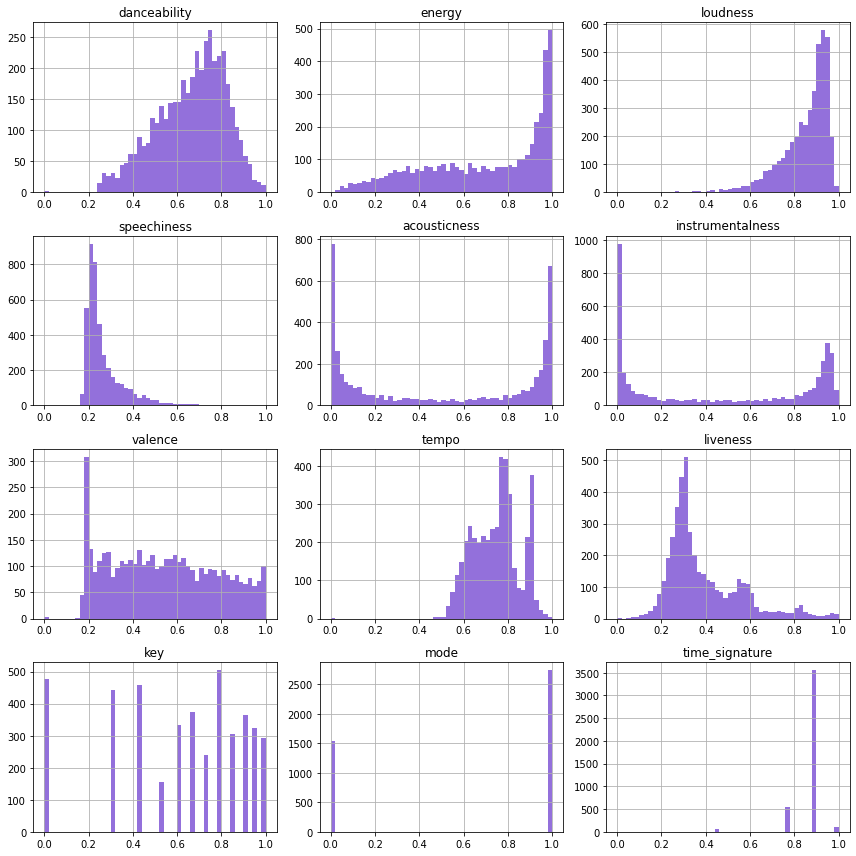

In [ ]:
# Hacemos los Histogramas para analizar el resultado de la transformacion
draw_histograms(X_features_SQ, X_features_SQ.columns, 4, 3)

Luego de esta transformación se observa:

- Energy y Loudness resultan en una distribución Sesgada a Izquierda
- Speechness resulta en una distribución Sesgada a Derecha
- Acousticness, Instrumentalness, Key, Time_signature no parecieran verse mejoradas en su distribución por esta transformación
- Valence se ve levemente mejorada por la transformación
- Tempo & Liveness se ven Mejoradas por la transformación

### Logaritmo
Se aplica una transformación Logarítmica a lo datos. Estrictamente, se utiliza el Log(x+1) debido a la presencia de valores 0. Nuevamente, la transformación se realiza sobre los datos estandarizados por Min-Max.

In [ ]:
# Logaritmo
X_features_LOG=X_features_norm2.transform(np.log1p) # Utilizamos el log(x+1) ya que el DF tiene muchos ceros
X_features_LOG.describe()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,valence,tempo,liveness,key,mode,time_signature
count,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000,4270.000000
mean,0.373636,0.415710,0.547616,0.073618,0.302370,0.289924,0.278876,0.445385,0.155671,0.362223,0.444134,0.568487
std,0.136060,0.229416,0.100793,0.055353,0.295512,0.282200,0.195135,0.098758,0.128814,0.224692,0.332598,0.068004
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.272236,0.200482,0.496183,0.043386,0.001866,0.000800,0.104040,0.364364,0.074587,0.167054,0.000000,0.587787
50%,0.389124,0.460223,0.579677,0.053170,0.194628,0.205617,0.244637,0.455864,0.100600,0.374693,0.693147,0.587787
75%,0.478163,0.641190,0.623353,0.078947,0.644677,0.611630,0.433659,0.504081,0.201750,0.546544,0.693147,0.587787
max,0.693147,0.693147,0.693147,0.693147,0.693147,0.693147,0.693147,0.693147,0.693147,0.693147,0.693147,0.693147


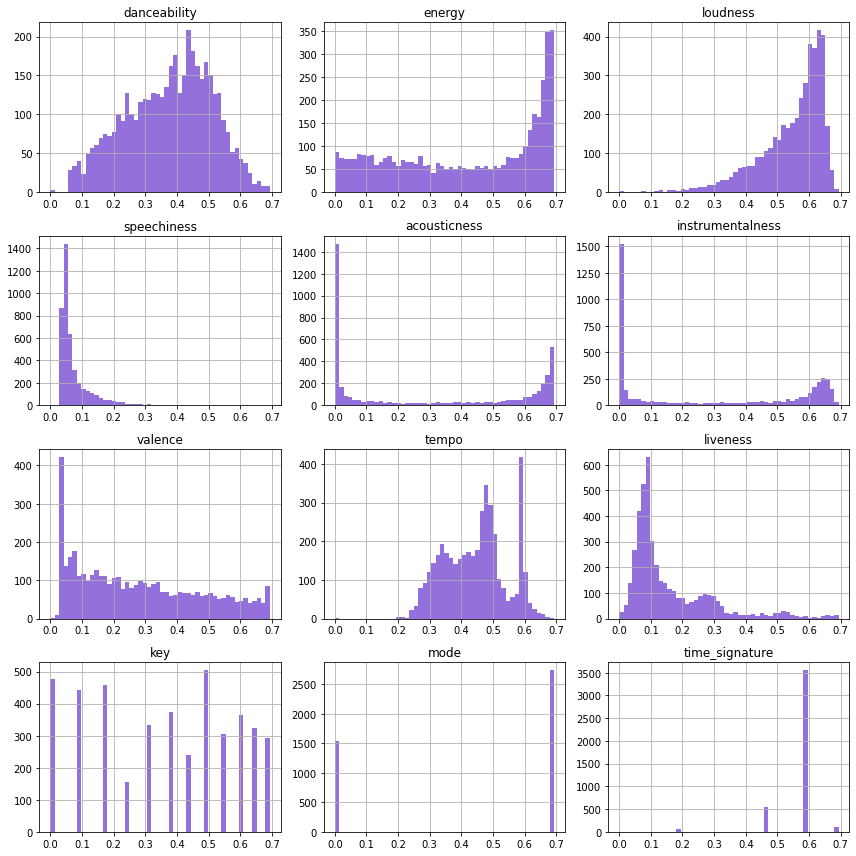

In [ ]:
# Vemos como quedan los histogramas con esta transformacion
draw_histograms(X_features_LOG, X_features_LOG.columns, 4, 3)

Conclusiones respecto de esta transformación:

- Energy queda con una distribución Sesgada a Izquierda (pero menos sesgada que con la transformación SQR)
- Loudness queda con una distribución Sesgada a Izquierda
- Speechness queda con una distribución Sesgada a Derecha
- Acousticness, Instrumentalness, Key, Time_signature no se ven mejoradas por esta transformación
- Valence se ve levemente mejorada por la transformación (aunque mejor con la transformación por SQR)
- Tempo, Liveness se ven mejoradas por las transformaciones (aunque no mejor que con la transformación SQR)

### Box-Cox

Se intenta realizar una transformación utilizando el método de Box & Cox. Sin embargo, se encuentra el inconveniente de que Box-Cox trabaja con valores Positivos exclusivamente. El dataset de audio_features estandarizado por Min-Max presenta valores 0. La alternativa a este método es la Transformación de Yeo-Jhonson

Referencias:

https://www.geeksforgeeks.org/box-cox-transformation-using-python/

https://feature-engine.readthedocs.io/en/latest/vartransformers/BoxCoxTransformer.html

###Yeo-Jhonson

Se realiza la transformación de Yeo-Jhonsons.

Referencias: 

https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.PowerTransformer.html#sklearn.preprocessing.PowerTransformer

In [ ]:
pt = PowerTransformer()

# Estimate the optimal parameter lambda for each feature
pt.fit(X_features_norm2)

# Apply the power transform to each feature using the fitted lambdas
X_features_JJ=pt.transform(X_features_norm2)

# Convierto en Panda DF
X_features_JJ = pd.DataFrame(X_features_JJ)

# Seteo nombres columnas
X_features_JJ.columns = ['danceability','energy','loudness','speechiness','acousticness','instrumentalness','valence','tempo','liveness','key','mode','time_signature']

X_features_JJ.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,valence,tempo,liveness,key,mode,time_signature
0,0.878667,1.217690,1.102719,1.629793,-1.039119,1.145986,-0.025747,1.458015,-1.024850,0.539501,0.748781,0.206803
1,-2.039601,-1.442889,-1.647018,-0.622518,1.266464,0.656283,-1.407749,-1.517770,-0.345863,-0.892788,-1.335505,-1.757335
2,-0.980468,-0.925056,-0.788973,-0.628529,0.519492,-1.054125,0.103395,1.621146,-1.134293,-0.892788,0.748781,-1.757335
3,-1.073681,-0.338509,0.507088,-1.179984,0.444542,-1.053130,-1.054781,-1.088373,0.457381,-0.297366,-1.335505,0.206803
4,1.391507,0.737854,0.903946,1.794081,-0.368175,-1.037273,1.759535,0.771552,-0.259917,1.066693,0.748781,0.206803


Visualizamos los histogramas de los datos Transformados

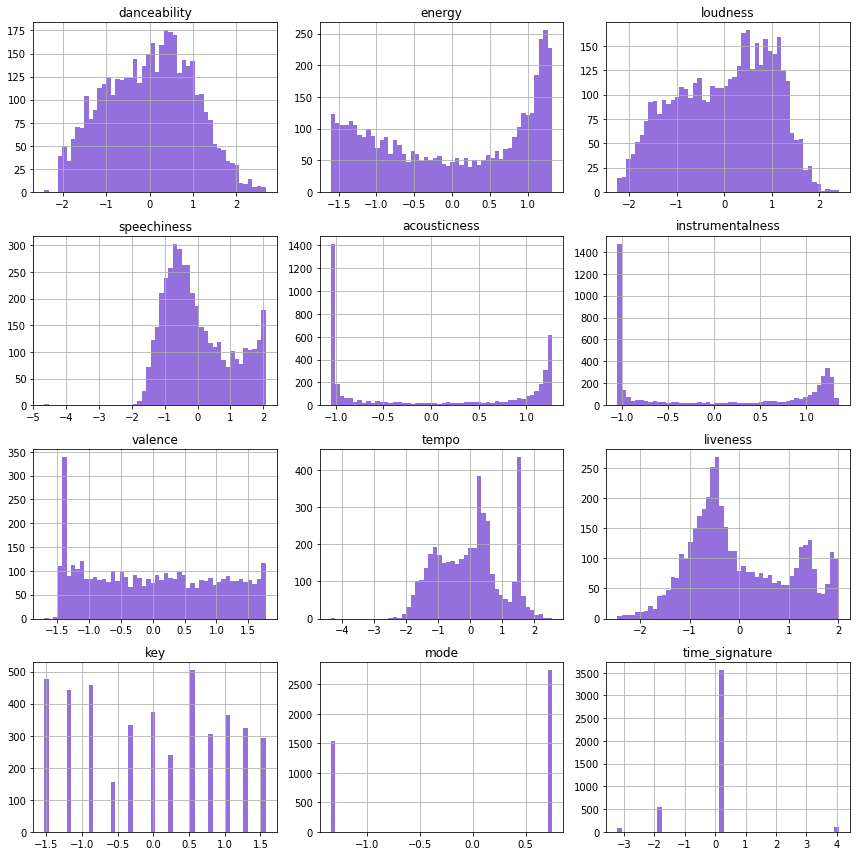

In [ ]:
# Chequeamos los Histogramas
draw_histograms(X_features_JJ, X_features_JJ.columns, 4, 3)

Conclusiones respecto de esta transformación:

- Energy queda levemente Sesgada a Izquierda (aunque con menos sesgo que con las transformaciones SQR y LOG)
- Loudness y Speechness quedan notablemente Mejoradas con esta transformación
- Acousticness, Instrumentalness, Key  no se ven mejoradas por esta transformación
- Valence se ve levemente mejorada por la transformación (pero mejor que con SQR y LOG). La distribución que se observa se asemeja más a una Uniforme
-  Tempo y Liveness mejoran considerablemente 

### Cuantiles

Finalmente realizamos una transformación mediante Cuantiles.

https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.quantile_transform.html

https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.QuantileTransformer.html#sklearn.preprocessing.QuantileTransformer

In [ ]:
X_features_QT1=quantile_transform(X_features_norm2, n_quantiles=1000, random_state=0, copy=True,output_distribution='normal')


# Convierto en Panda DF
X_features_QT1 = pd.DataFrame(X_features_QT1)

# Seteo nombres columnas
X_features_QT1.columns = ['danceability','energy','loudness','speechiness','acousticness','instrumentalness','valence','tempo','liveness','key','mode','time_signature']

X_features_QT1.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,valence,tempo,liveness,key,mode,time_signature
0,0.810910,1.264066,1.035555,1.269664,-0.622040,0.728240,0.007527,1.130744,-1.124870,0.245840,5.199338,0.147316
1,-2.474160,-1.463311,-1.588126,-0.466803,2.289988,0.257224,-1.639539,-1.550858,-0.057742,-0.616541,-5.199338,-1.404533
2,-0.851675,-0.628724,-0.648800,-0.472407,0.205941,-1.243405,0.096753,1.922028,-1.275302,-0.616541,5.199338,-1.404533
3,-0.955471,-0.202527,0.342160,-1.381364,0.180312,-0.798713,-0.787152,-0.946818,0.475214,-0.260089,-5.199338,0.147316
4,1.421556,0.357496,0.761322,1.458748,-0.030114,-0.502629,2.800211,0.800799,0.023839,0.741388,5.199338,0.147316


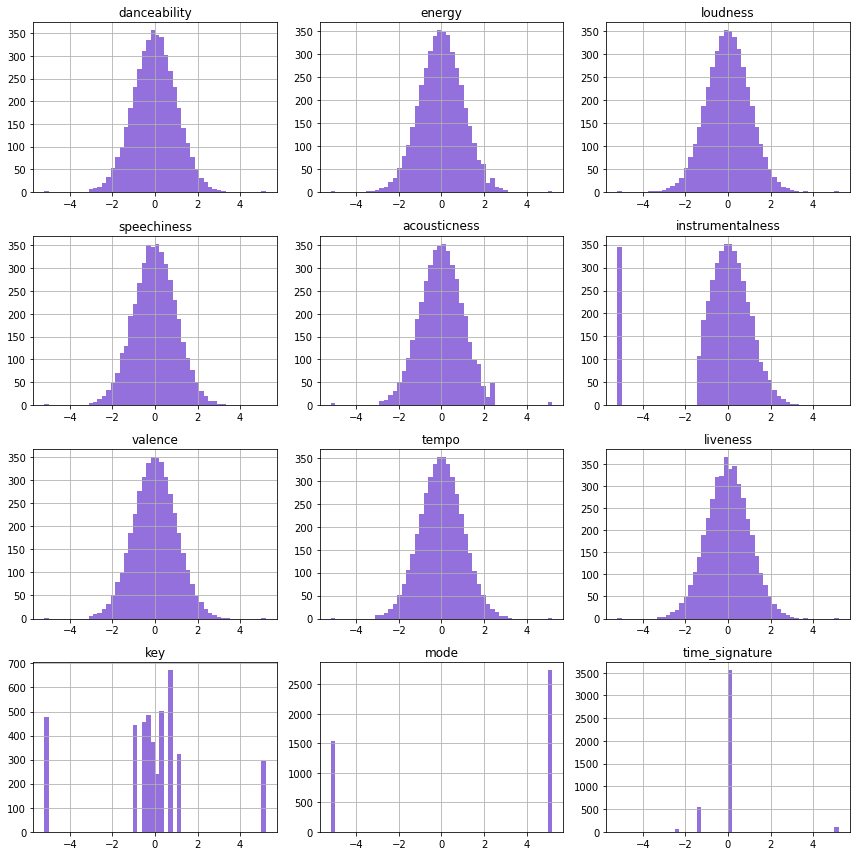

In [ ]:
# Chequeamos los Histogramas
draw_histograms(X_features_QT1, X_features_QT1.columns, 4, 3)

La transformación por Cuantiles arroja distribuciones muy semejantes a la Normal Standard para todas las variables, a excepción de Key, time_signature y duration_ms que son las variables Discretas.

A partir de todas las transformacione realizadas, se decidió generar un nuevo DataFrame donde las variables Discretas (Key, time_signature y mode) se toman del DataFrame estandarizado por Min-Max, y el resto de las variables se toman del DataFrame transformado por Cuantiles.

In [ ]:
X_features_minmax=X_features_norm2[['key','time_signature','mode']]
X_features_cuantiles=X_features_QT1[['danceability','energy','loudness','speechiness','acousticness','instrumentalness','valence','tempo','liveness']]
X_features_final=pd.concat([X_features_minmax, X_features_cuantiles], axis=1, sort=False)
X_features_final.head()

,key,time_signature,mode,danceability,energy,loudness,speechiness,acousticness,instrumentalness,valence,tempo,liveness
0,0.636364,0.8,1.0,0.810910,1.264066,1.035555,1.269664,-0.622040,0.728240,0.007527,1.130744,-1.124870
1,0.181818,0.6,0.0,-2.474160,-1.463311,-1.588126,-0.466803,2.289988,0.257224,-1.639539,-1.550858,-0.057742
2,0.181818,0.6,1.0,-0.851675,-0.628724,-0.648800,-0.472407,0.205941,-1.243405,0.096753,1.922028,-1.275302
3,0.363636,0.8,0.0,-0.955471,-0.202527,0.342160,-1.381364,0.180312,-0.798713,-0.787152,-0.946818,0.475214
4,0.818182,0.8,1.0,1.421556,0.357496,0.761322,1.458748,-0.030114,-0.502629,2.800211,0.800799,0.023839


## QQ Plots 

Hacemos los QQplots correspondientes a partir del DataFrame 'final' para chequear normalidad.

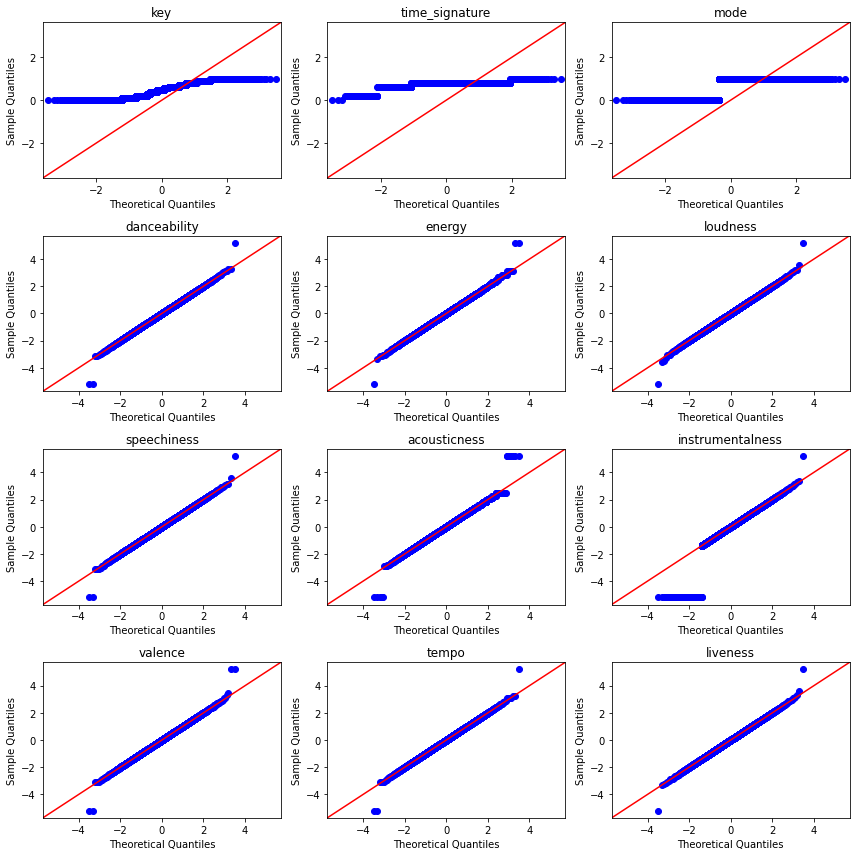

In [ ]:
# Definimos una funcion para hacer varios QQPlots
def draw_QQplots(df, variables, n_rows, n_cols):
    fig=plt.figure(figsize=(12,12))
    for i, var_name in enumerate(variables):
        ax=fig.add_subplot(n_rows,n_cols,i+1)
        sm.qqplot(df[var_name],line='45', ax=ax)
        ax.set_title(var_name)
    fig.tight_layout()  # Improves appearance a bit.
    plt.show()

# Aplicamos la funcion en el dataset de variables continuas
draw_QQplots(X_features_final, X_features_final.columns, 4, 3)

Las variables normalizadas por Cuantiles muestran un comportamiento similar a la Normal Standard. No sucede lo mismo con las variables 'key', 'time_signature' y 'mode' que son las variables discretas que no transformamos.

## ScaterMatrix

Volvemos a Generar la ScatterMatrix con los datos transformados finales.

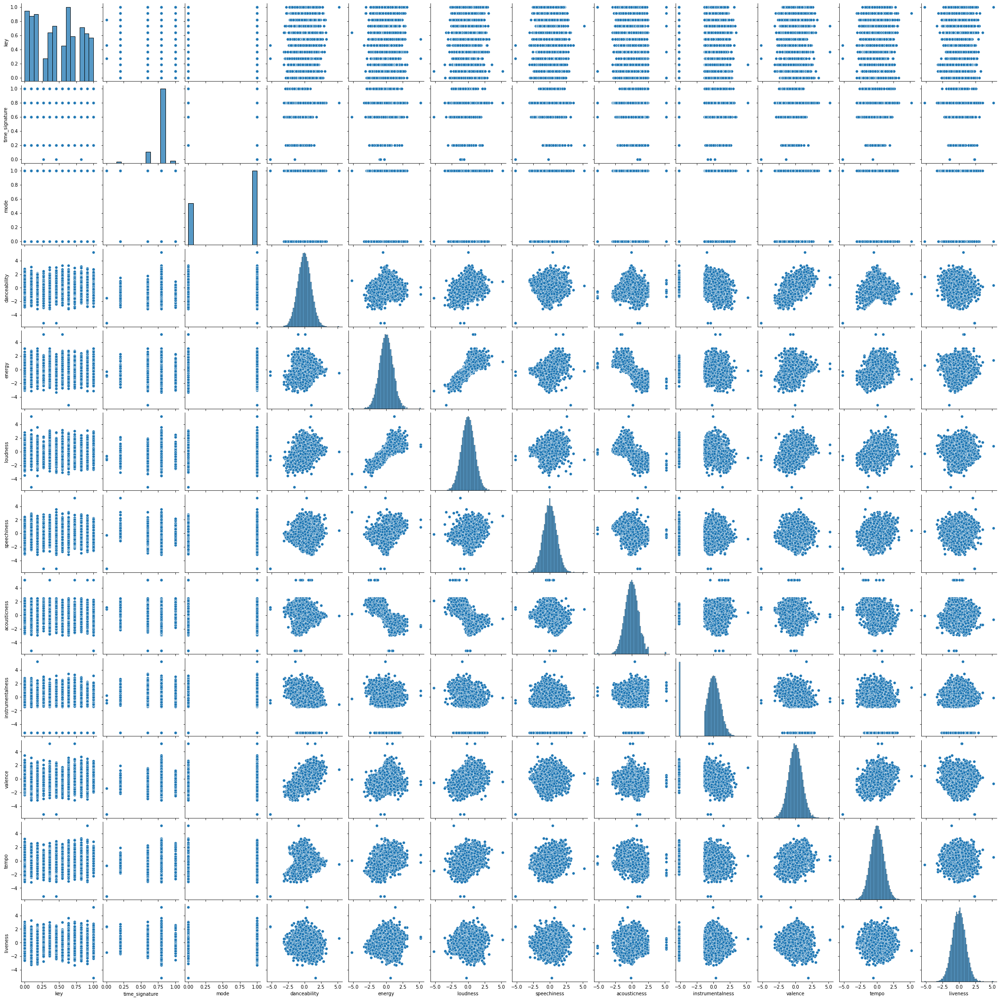

In [ ]:
#visualizar las features
sns.pairplot(X_features_final)

## Outliers

Hacemos un primer análisis de Outliers mediante Boxplots. En una primera instancia vamos a visualizar lox Boxplots de los datos originales y luego transformados.

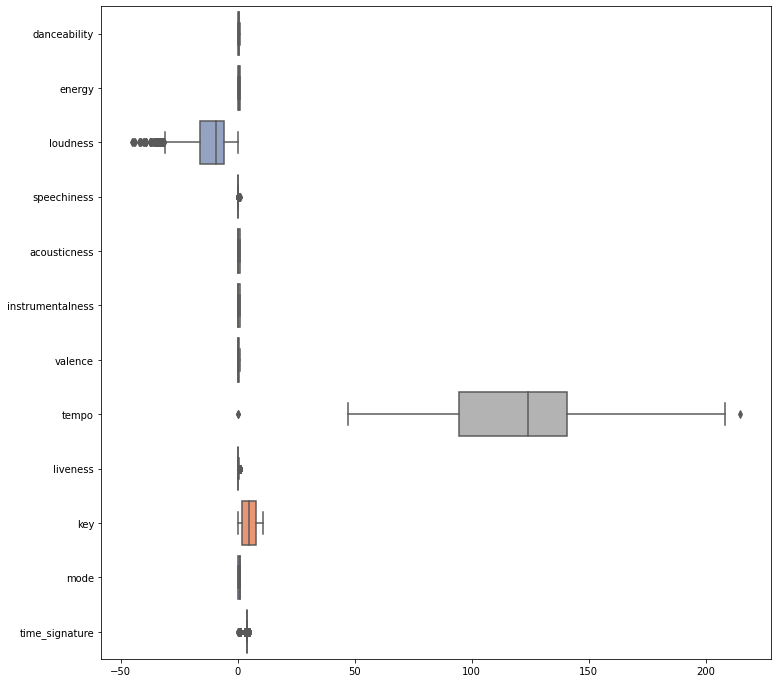

In [ ]:
# Hacemos un boxplot de los datos originales
fig=plt.figure(figsize=(12,12))
ax=sns.boxplot(data=X_features, orient="h", palette="Set2")

Al observar los Boxplots de los datos originales, se dificulta su visualización debido a las diferencias en las unidades de medición de los datos.

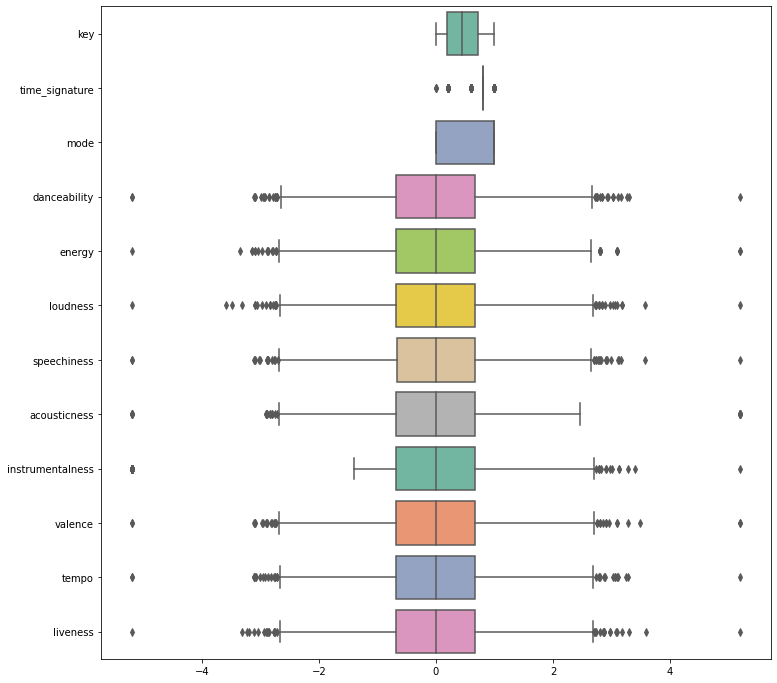

In [ ]:
# Draw a boxplot for each numeric variable in a DataFrame:
fig=plt.figure(figsize=(12,12))
ax=sns.boxplot(data=X_features_final, orient="h", palette="Set2")

Al visualizar los Boxplots de las variables transformadas, se observa en casi todos los casos Outliers severos por izquierda y derecha. Realizamos un filtrado de los datos que tienen valores menores a (-4) y mayores a (4).

In [ ]:
# Cantidad de Outliers con valores mayores a 4 y menores a -4
for x in X_features_final.columns:
  print(x,':',X_features_final[(X_features_final[x]<-4) | (X_features_final[x]>4)].shape[0],sep=" ")
  
# Total 376

key : 0
time_signature : 0
mode : 0
danceability : 3
energy : 3
loudness : 2
speechiness : 3
acousticness : 13
instrumentalness : 345
valence : 4
tempo : 3
liveness : 2


Como propuesta de eliminación de Outliers, y a partir de la observación gráfica de los Boxplots, creemos que el criterio más adecuado sería el de 3*IQR.

# Dataset *audio_analysis*

El dataset *audio_analysis* contiene las variables continuas de bajo nivel, estimadas en ventanas temporales, como *timbre* o *pitches*. Como primer paso, deberán:

-   Resumir estas variables en valores por canción. Por ejemplo, tomar el promedio o el desvío estándar del timbre entre todas las ventanas, obteniendo 12 valores de timbre promedio y 12 valores de desvío estándar del timbre por canción.

-   Contruir un *data frame* con estos valores.

-   Generar un gráfico tipo *scatter matrix*.

-   Identificar variables más o menos informativas *a priori* y variables que requieran, además de la estandarización, alguna corrección para asimilar la distribución a una normal.

-   Estandarizar y volver a generar un gráfico tipo *scatter matrix*.

-   Identificar, si es que hay, valores extremos que sea necesario descartar.

In [ ]:
df_aa.head()

,start,duration,confidence,loudness_start,loudness_max_time,loudness_max,loudness_end,pitches,timbre,id
0,0.00000,0.33061,0.000,-15.742,0.01269,-12.896,0.0,"[0.102, 0.103, 0.112, 0.21, 1.0, 0.068, 0.045,...","[43.022, 16.787, -40.89, 11.82, 105.068, -67.1...",6avAsaa2IsXHT2mtQ6cGVe
1,0.33061,0.36481,0.159,-22.482,0.08965,-18.792,0.0,"[0.008, 0.022, 0.029, 0.191, 1.0, 0.078, 0.013...","[38.644, -65.426, -9.06, -7.153, 135.949, -47....",6avAsaa2IsXHT2mtQ6cGVe
2,0.69542,0.53002,1.000,-23.472,0.00965,-7.144,0.0,"[0.037, 0.047, 0.063, 0.307, 1.0, 0.149, 0.06,...","[47.643, 50.817, 75.922, 53.108, 25.988, -42.0...",6avAsaa2IsXHT2mtQ6cGVe
3,1.22544,0.44059,0.626,-19.710,0.00809,-10.394,0.0,"[0.045, 0.067, 0.048, 0.131, 0.464, 0.104, 0.0...","[44.839, -20.55, 58.387, 38.347, 47.279, -59.7...",6avAsaa2IsXHT2mtQ6cGVe
4,1.66603,0.26816,0.082,-21.887,0.11164,-18.096,0.0,"[0.022, 0.045, 0.036, 0.149, 0.695, 0.147, 0.0...","[40.058, -29.617, 61.054, -12.254, 110.751, -4...",6avAsaa2IsXHT2mtQ6cGVe


## Procesamiento de Datos
Abrimos en columnas y sumarizamos los campos PITCHES y TIMBRES 

In [ ]:
# PROCESAMIENTO DEL DATASET AUDIO ANALISIS

# Nos quedamos solo con las columnas que nos interesan
df_aa_summary = df_aa[['pitches', 'timbre', 'id']]#.head(10000)
 
# Iteramos para separa cada valor y obtener una columna por cada uno de los pitches
for i in range(0,12):
  df_aa_summary['pitch_' + str(i)] = df_aa_summary.apply(lambda x : x['pitches'][i], axis=1)

# Iteramos para separa cada valor y obtener una columna por cada uno de los timbre
for i in range(0,12):
  df_aa_summary['timbre_' + str(i)] = df_aa_summary.apply(lambda x : x['timbre'][i], axis=1)

# Creamos un nuevo dataframe para calcular sobre este la media agrupado por ID de tema
df_aa_mean = df_aa_summary[['id',
                   'pitch_0', 'pitch_1', 'pitch_2', 'pitch_3', 'pitch_4', 'pitch_5', 
                   'pitch_6', 'pitch_7', 'pitch_8', 'pitch_9', 'pitch_10', 'pitch_11', 
                   'timbre_0', 'timbre_1', 'timbre_2', 'timbre_3', 'timbre_4', 'timbre_5', 
                   'timbre_6', 'timbre_7', 'timbre_8', 'timbre_9', 'timbre_10', 'timbre_11']]
df_aa_mean = df_aa_mean.groupby(['id'], as_index=False).mean()
df_aa_mean.columns = ['id',
                   'pitch_0_mean', 'pitch_1_mean', 'pitch_2_mean', 'pitch_3_mean', 'pitch_4_mean', 'pitch_5_mean', 
                   'pitch_6_mean', 'pitch_7_mean', 'pitch_8_mean', 'pitch_9_mean', 'pitch_10_mean', 'pitch_11_mean', 
                   'timbre_0_mean', 'timbre_1_mean', 'timbre_2_mean', 'timbre_3_mean', 'timbre_4_mean', 'timbre_5_mean', 
                   'timbre_6_mean', 'timbre_7_mean', 'timbre_8_mean', 'timbre_9_mean', 'timbre_10_mean', 'timbre_11_mean']

# Creamos un nuevo dataframe para calcular sobre este el desvio standard agrupado por ID de tema
df_aa_std = df_aa_summary[['id',
                   'pitch_0', 'pitch_1', 'pitch_2', 'pitch_3', 'pitch_4', 'pitch_5', 
                   'pitch_6', 'pitch_7', 'pitch_8', 'pitch_9', 'pitch_10', 'pitch_11', 
                   'timbre_0', 'timbre_1', 'timbre_2', 'timbre_3', 'timbre_4', 'timbre_5', 
                   'timbre_6', 'timbre_7', 'timbre_8', 'timbre_9', 'timbre_10', 'timbre_11' ]]
df_aa_std  = df_aa_std.groupby(['id'], as_index=False).std()
df_aa_std.columns = ['id',
                   'pitch_0_std', 'pitch_1_std', 'pitch_2_std', 'pitch_3_std', 'pitch_4_std', 'pitch_5_std', 
                   'pitch_6_std', 'pitch_7_std', 'pitch_8_std', 'pitch_9_std', 'pitch_10_std', 'pitch_11_std', 
                   'timbre_0_std', 'timbre_1_std', 'timbre_2_std', 'timbre_3_std', 'timbre_4_std', 'timbre_5_std', 
                   'timbre_6_std', 'timbre_7_std', 'timbre_8_std', 'timbre_9_std', 'timbre_10_std', 'timbre_11_std']

# Finalmente junto en un solo DF las variables resumidas de pitches y timbres por tema
df_aa_summary = pd.merge(df_aa_mean, df_aa_std, on='id')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
# Borramos los datos que no se van a utizar mas para liberar memoria
del df_aa_mean
del df_aa_std
del df_aa

In [ ]:
# Armamos un dataframe final con todos los atributos juntos por tema
X_features_final['id'] = X_features.index
df_tracks_01['id'] = df_tracks.index
df_full = pd.merge(df_tracks_01, X_features_final, on='id') ####
df_full = pd.merge(df_full, df_aa_summary, on='id')  

In [ ]:
df_full.shape

(4082, 67)

### Guardamos un backup de todos los datos en el Drive

In [ ]:
# Para montar el Google Drive y acceder a los archivos.
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Guardamos los datos en el drive para que no los tengamos que generar cada vez que corremos el programa

df_tracks_01.to_pickle('./drive/My Drive/DMCyT/TP01/df_tracks_01.pkl')
X_features_final.to_pickle('./drive/My Drive/DMCyT/TP01/X_features_final.pkl')
df_aa_summary.to_pickle('./drive/My Drive/DMCyT/TP01/df_aa_summary.pkl')
df_full.to_pickle('./drive/My Drive/DMCyT/TP01/df_full.pkl')


In [ ]:
# Leemos los archivos del Drive
## SE COMENTA LOS ARCHIVOS QUE NO NECESITAMOS PARA EVITAR EL CONSUMO INNECESARIO DE MEMORIA

#df_tracks_01      = pd.read_pickle('./drive/My Drive/DMCyT/TP01/df_tracks_01.pkl')
#X_features_final  = pd.read_pickle('./drive/My Drive/DMCyT/TP01/X_features_final.pkl')
#df_aa_summary     = pd.read_pickle('./drive/My Drive/DMCyT/TP01/df_aa_summary.pkl')
df_full           = pd.read_pickle('./drive/My Drive/DMCyT/TP01/df_full.pkl')

In [ ]:
df_full.head()

,album,artists,release_date,genre,album_type,name,id,key,time_signature,mode,danceability,energy,loudness,speechiness,acousticness,instrumentalness,valence,tempo,liveness,pitch_0_mean,pitch_1_mean,pitch_2_mean,pitch_3_mean,pitch_4_mean,pitch_5_mean,pitch_6_mean,pitch_7_mean,pitch_8_mean,pitch_9_mean,pitch_10_mean,pitch_11_mean,timbre_0_mean,timbre_1_mean,timbre_2_mean,timbre_3_mean,timbre_4_mean,timbre_5_mean,timbre_6_mean,timbre_7_mean,timbre_8_mean,timbre_9_mean,timbre_10_mean,timbre_11_mean,pitch_0_std,pitch_1_std,pitch_2_std,pitch_3_std,pitch_4_std,pitch_5_std,pitch_6_std,pitch_7_std,pitch_8_std,pitch_9_std,pitch_10_std,pitch_11_std,timbre_0_std,timbre_1_std,timbre_2_std,timbre_3_std,timbre_4_std,timbre_5_std,timbre_6_std,timbre_7_std,timbre_8_std,timbre_9_std,timbre_10_std,timbre_11_std
0,"{'album_type': 'ALBUM', 'artists': [{'external...",Tommy Flanagan,1991.0,jazz,ALBUM,Master Trio,4d3XHYFFuYYzxWr2cJ6yQl,0.454545,0.8,1.0,0.172731,-0.939480,-0.922407,0.243255,0.601439,0.630254,-0.496390,-0.301263,0.270485,0.298535,0.180659,0.155409,0.175122,0.371660,0.245970,0.213893,0.180280,0.229404,0.327082,0.150271,0.224233,33.200803,-49.493368,9.836419,36.733842,26.529059,-23.574390,7.424020,-0.710288,-4.410177,4.198041,-14.659899,2.688226,0.331344,0.260306,0.237757,0.236816,0.361030,0.314573,0.280958,0.256829,0.296475,0.356470,0.225644,0.308127,7.639213,69.581382,55.159355,54.916062,33.010550,34.240115,35.196478,21.675910,22.925153,16.287025,20.597903,19.541431
1,"{'album_type': 'ALBUM', 'artists': [{'external...",Art Farmer,1958.0,jazz,ALBUM,Modern Art,3X3p3u03P8eFL8WTH0oaaU,0.636364,0.8,1.0,0.879040,-0.722706,-0.678475,-0.182928,0.590949,0.116941,0.593940,-0.618085,-1.286804,0.339976,0.344597,0.256260,0.180761,0.257806,0.215097,0.220464,0.312258,0.228816,0.219027,0.224503,0.285837,38.807412,-15.183463,3.166291,3.009480,33.125766,-17.094660,1.016095,9.584543,-10.411660,2.383247,-14.933597,2.526914,0.317413,0.294871,0.307896,0.242177,0.316163,0.266367,0.258511,0.347301,0.258093,0.275410,0.280947,0.317595,5.570898,53.523530,56.980886,46.217379,20.654219,29.730918,22.449643,21.648536,15.395235,15.021366,19.194473,15.720201
2,"{'album_type': 'ALBUM', 'artists': [{'external...",Christian Scott aTunde Adjuah,2014.0,jazz,ALBUM,Christian Scott Collection,4KlXeaheot0OI9PoOWspvZ,0.818182,0.8,0.0,1.976943,-0.476599,-0.050437,-0.400635,0.216450,0.627196,0.437757,-0.802877,-1.122963,0.302935,0.256534,0.306165,0.185311,0.353993,0.196076,0.204357,0.298317,0.183601,0.413397,0.278325,0.343216,41.241254,-38.759706,-25.768553,13.873919,27.528258,-23.727586,-6.149205,-3.552485,3.328325,-3.445111,-12.809965,6.271921,0.304727,0.290790,0.345668,0.204735,0.349863,0.239410,0.264117,0.374368,0.231476,0.367954,0.280048,0.347446,7.075858,64.980997,74.278702,78.204415,29.974543,44.321367,23.476873,23.920097,15.259123,18.096970,24.171626,11.729183
3,"{'album_type': 'ALBUM', 'artists': [{'external...",Skalpel,2014.0,jazz,ALBUM,Transit,3j76McoUI18gDoqxYE14Bu,0.181818,0.8,1.0,1.231280,-0.071571,-0.686519,-1.456896,0.340169,0.334851,0.182928,-0.160054,1.786156,0.321853,0.520767,0.362561,0.260940,0.609802,0.241014,0.484756,0.408949,0.286877,0.562099,0.242905,0.370855,37.711023,-60.093389,-50.472714,-7.599682,55.505600,-40.476179,-15.745223,-18.364033,-8.566265,-2.953032,-6.123940,-2.122899,0.273936,0.330068,0.269892,0.197076,0.309966,0.209285,0.321866,0.270208,0.228052,0.343848,0.192607,0.265125,5.345223,62.199995,40.779450,39.535191,33.799713,31.444914,22.422720,26.911989,18.558291,22.579538,16.842831,13.899760
4,"{'album_type': 'ALBUM', 'artists': [{'external...",Miles Davis,1959.0,jazz,ALBUM,Kind Of Blue (Legacy Edition),4zxd4tiXPlWMqoJltbVTbE,0.909091,0.8,1.0,0.163824,-0.945616,-0.357936,-0.840906,0.716839,-0.868663,-0.076604,-0.952501,-0.586473,0.281749,0.220966,0.319835,0.246768,0.193175,0.322527,0.189725,0.253141,0.210850,0.289870,0.362443,0.190660,38.966243,11.560832,1.424809,-11.674159,40.548104,-8.272561,-33.213228,0.973276,2.047305,0.839688,-9.085866,-5.

## Normalización y Estandarización

A continuación, analizamos  las 12 variables de media y las 12 variables de STD para los pitches y los timbres de las canciones. Observamos que estas variables presentan en su mayoría una distribución normal. Realizamos la estandarización y la transformación por cuantiles para asimilar todas las distribuciones a una normal como requiere la consigna.


### Medias de los Pitches

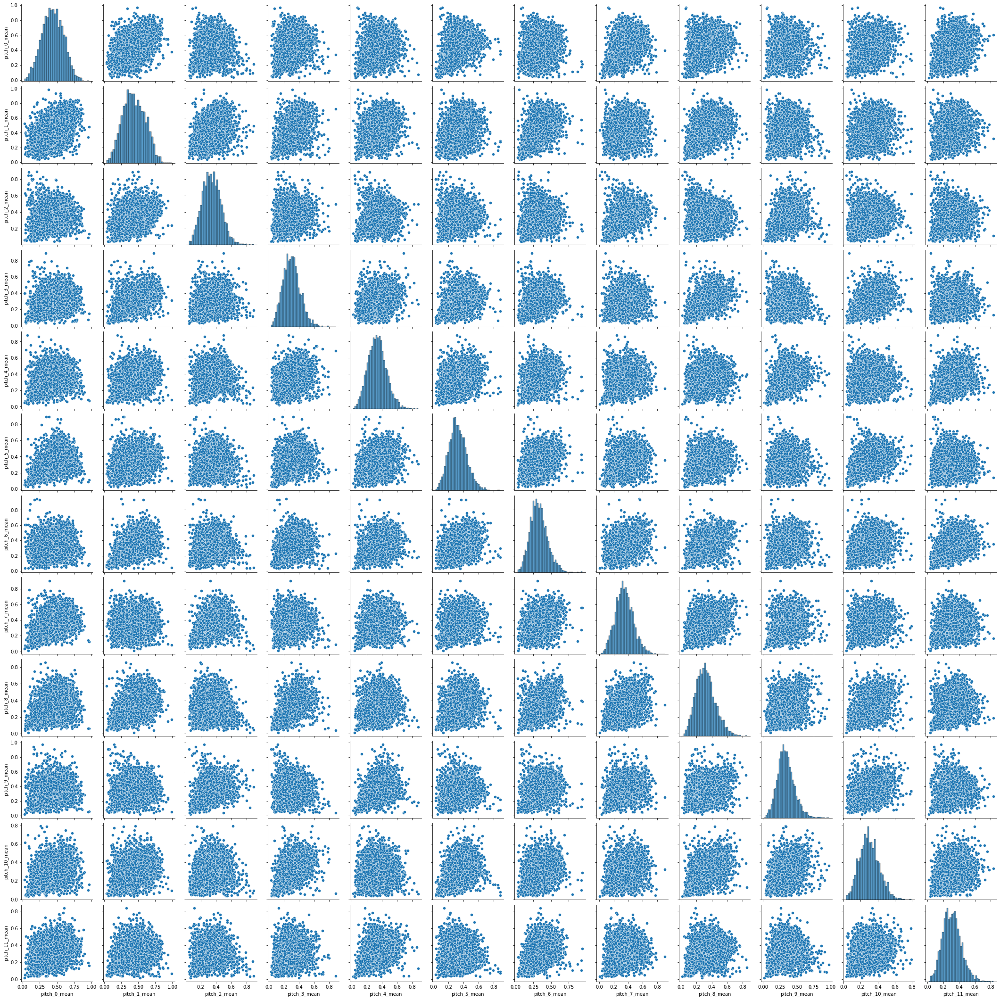

In [ ]:
# Hacemos un pairplot para los promedios de Pitches antes de efectuar las normalizaciones y las transformaciones
df_pitches_mean = df_full[['pitch_0_mean','pitch_1_mean','pitch_2_mean','pitch_3_mean','pitch_4_mean','pitch_5_mean','pitch_6_mean','pitch_7_mean','pitch_8_mean','pitch_9_mean','pitch_10_mean','pitch_11_mean']]
sns.pairplot(df_pitches_mean)

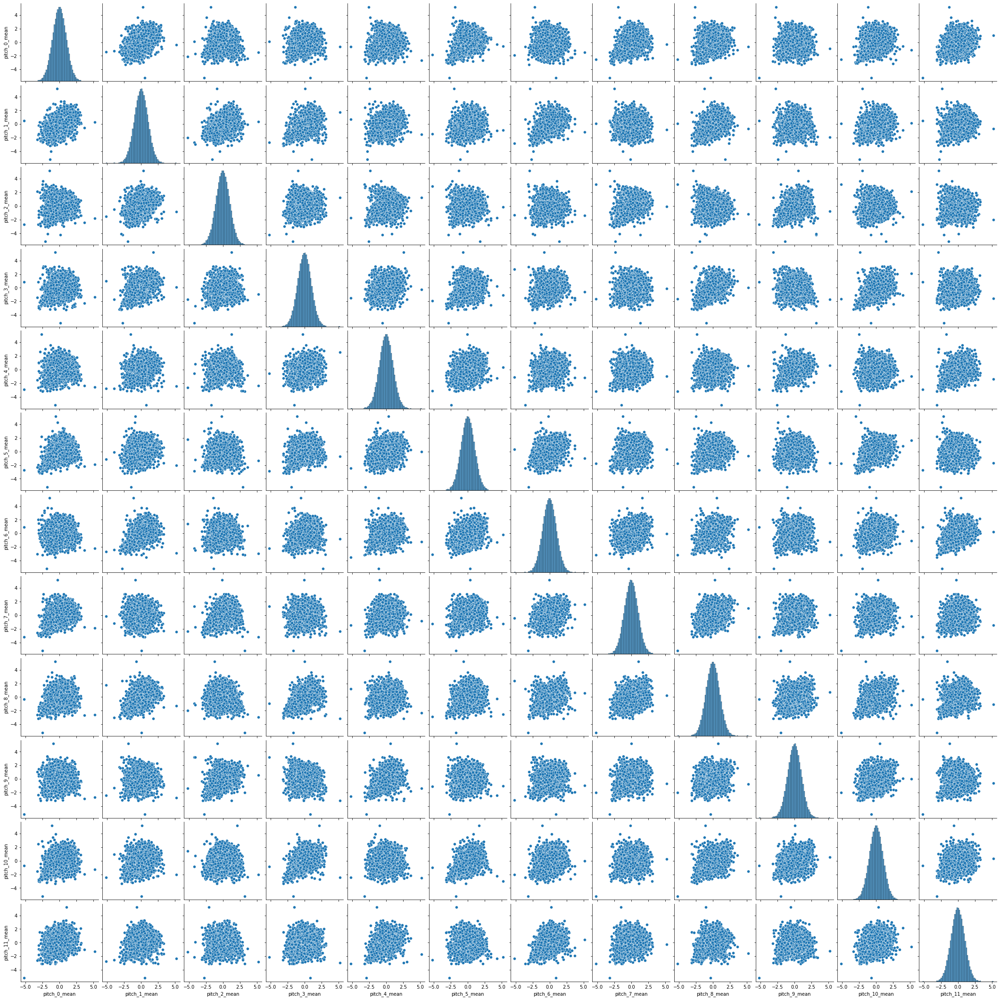

In [ ]:
# Normalizamos por min-max
MMS = MinMaxScaler()
df_pitches_mean_norm = MMS.fit_transform(df_pitches_mean) 
df_pitches_mean_norm = pd.DataFrame(df_pitches_mean_norm)
df_pitches_mean_norm.columns = ['pitch_0_mean','pitch_1_mean','pitch_2_mean','pitch_3_mean','pitch_4_mean','pitch_5_mean','pitch_6_mean','pitch_7_mean','pitch_8_mean','pitch_9_mean','pitch_10_mean','pitch_11_mean']

# Transformamos por Cuantiles
df_pitches_mean_norm_QT1 = quantile_transform(df_pitches_mean_norm, n_quantiles=1000, random_state=0, copy=True,output_distribution='normal')
df_pitches_mean_norm_QT1  = pd.DataFrame(df_pitches_mean_norm_QT1 )
df_pitches_mean_norm_QT1.columns = ['pitch_0_mean','pitch_1_mean','pitch_2_mean','pitch_3_mean','pitch_4_mean','pitch_5_mean','pitch_6_mean','pitch_7_mean','pitch_8_mean','pitch_9_mean','pitch_10_mean','pitch_11_mean']

# Verificamos como quedó el grafico de pares con las variables normalizadas y estandarizadas 
sns.pairplot(df_pitches_mean_norm_QT1)


### Desvíos de los Pitches

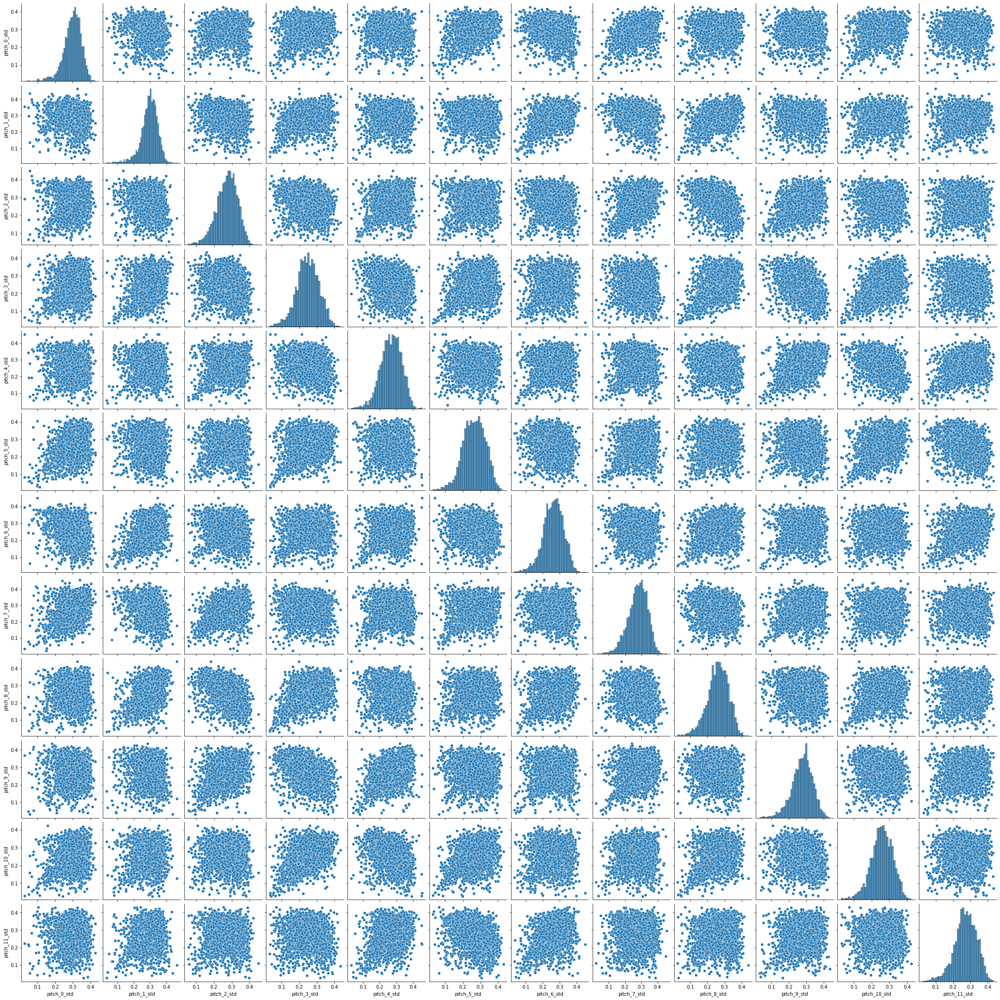

In [ ]:
# Hacemos un pairplot para los desvios de Pitches
df_pitches_std = df_full[['pitch_0_std','pitch_1_std','pitch_2_std','pitch_3_std','pitch_4_std','pitch_5_std','pitch_6_std','pitch_7_std','pitch_8_std','pitch_9_std','pitch_10_std','pitch_11_std']]
sns.pairplot(df_pitches_std)


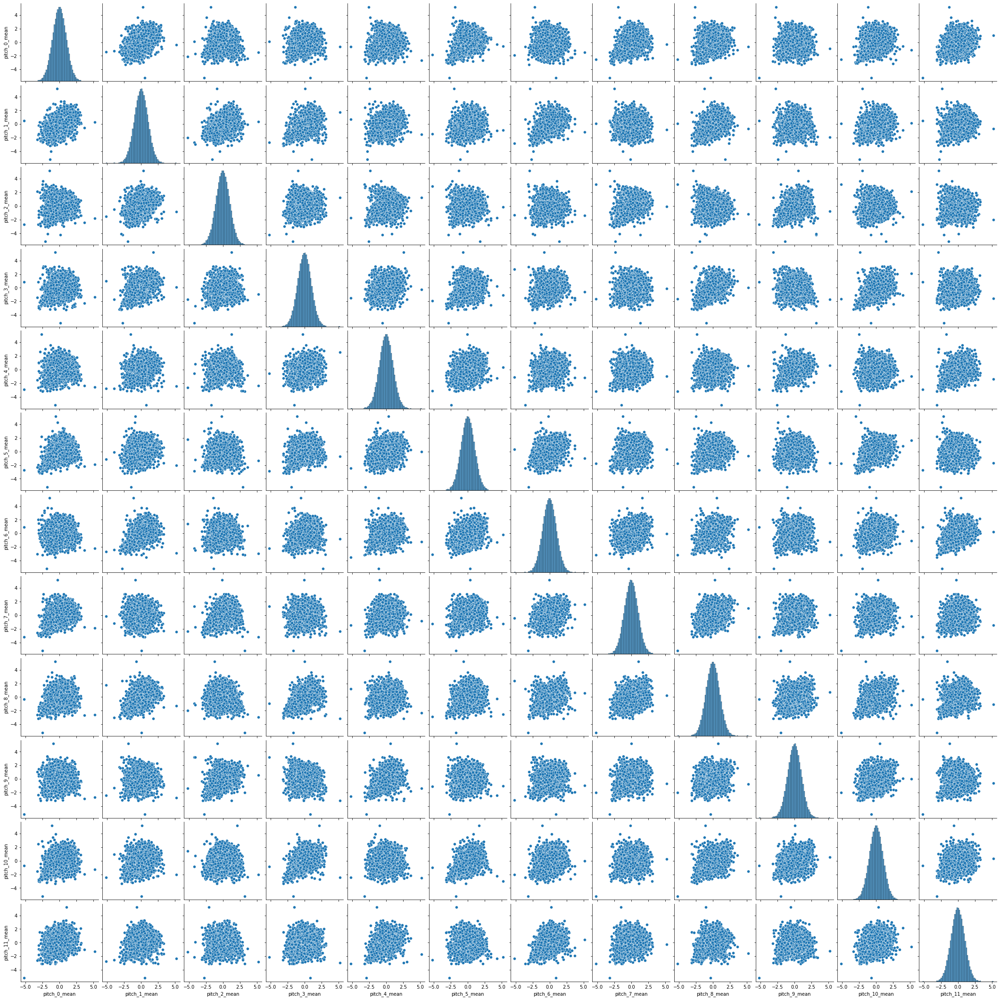

In [ ]:
# Normalizamos por min-max
MMS = MinMaxScaler()
df_pitches_std_norm         = MMS.fit_transform(df_pitches_std) 
df_pitches_std_norm         = pd.DataFrame(df_pitches_std_norm)
df_pitches_std_norm.columns = ['pitch_0_std','pitch_1_std','pitch_2_std','pitch_3_std','pitch_4_std','pitch_5_std','pitch_6_std','pitch_7_std','pitch_8_std','pitch_9_std','pitch_10_std','pitch_11_std']

# Transformamos por Cuantiles
df_pitches_std_norm_QT1         = quantile_transform(df_pitches_std_norm, n_quantiles=1000, random_state=0, copy=True,output_distribution='normal')
df_pitches_std_norm_QT1         = pd.DataFrame(df_pitches_std_norm_QT1 )
df_pitches_std_norm_QT1.columns = ['pitch_0_std','pitch_1_std','pitch_2_std','pitch_3_std','pitch_4_std','pitch_5_std','pitch_6_std','pitch_7_std','pitch_8_std','pitch_9_std','pitch_10_std','pitch_11_std']

# Verificamos como quedó el grafico de pares con las variables normalizadas y estandarizadas 
sns.pairplot(df_pitches_mean_norm_QT1)


### Medias de los Timbres

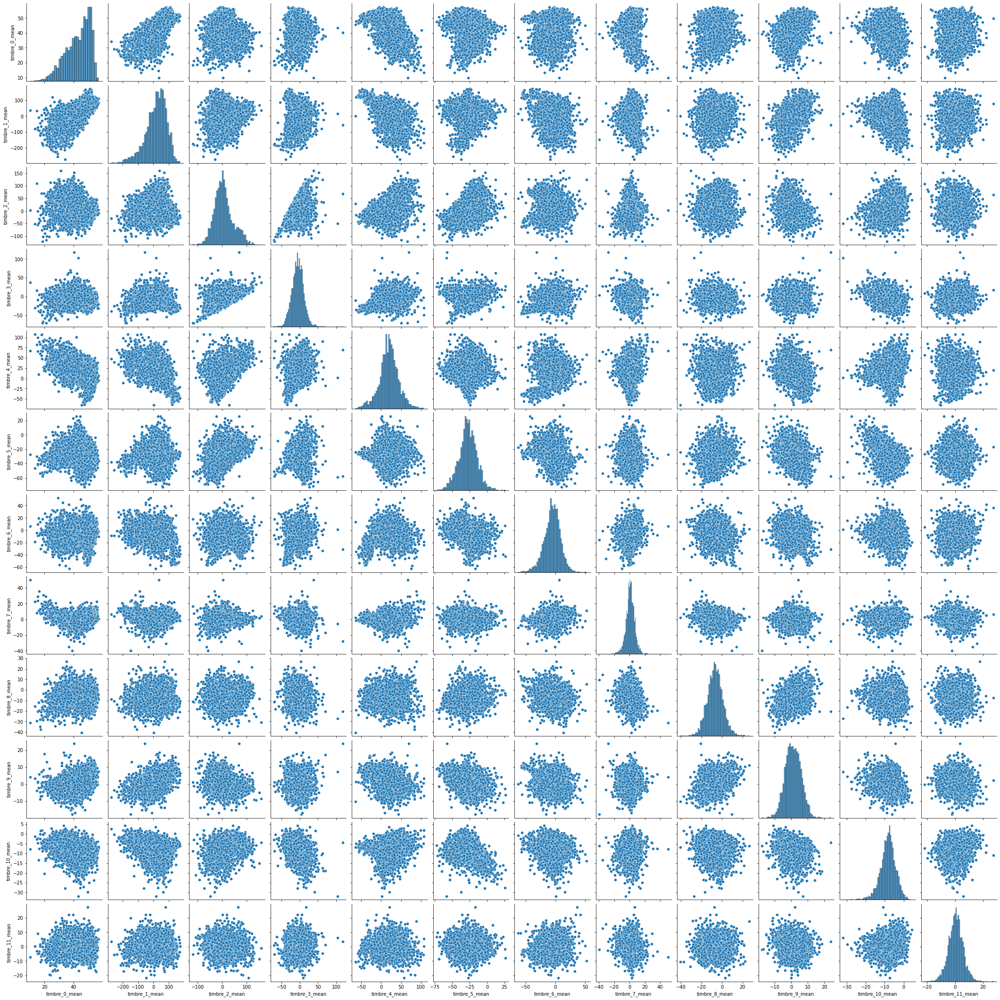

In [ ]:
# Hacemos un pairplot para los promedios de Timbres
df_timbres_mean = df_full[['timbre_0_mean','timbre_1_mean','timbre_2_mean','timbre_3_mean','timbre_4_mean','timbre_5_mean','timbre_6_mean','timbre_7_mean','timbre_8_mean','timbre_9_mean','timbre_10_mean','timbre_11_mean']]
sns.pairplot(df_timbres_mean)

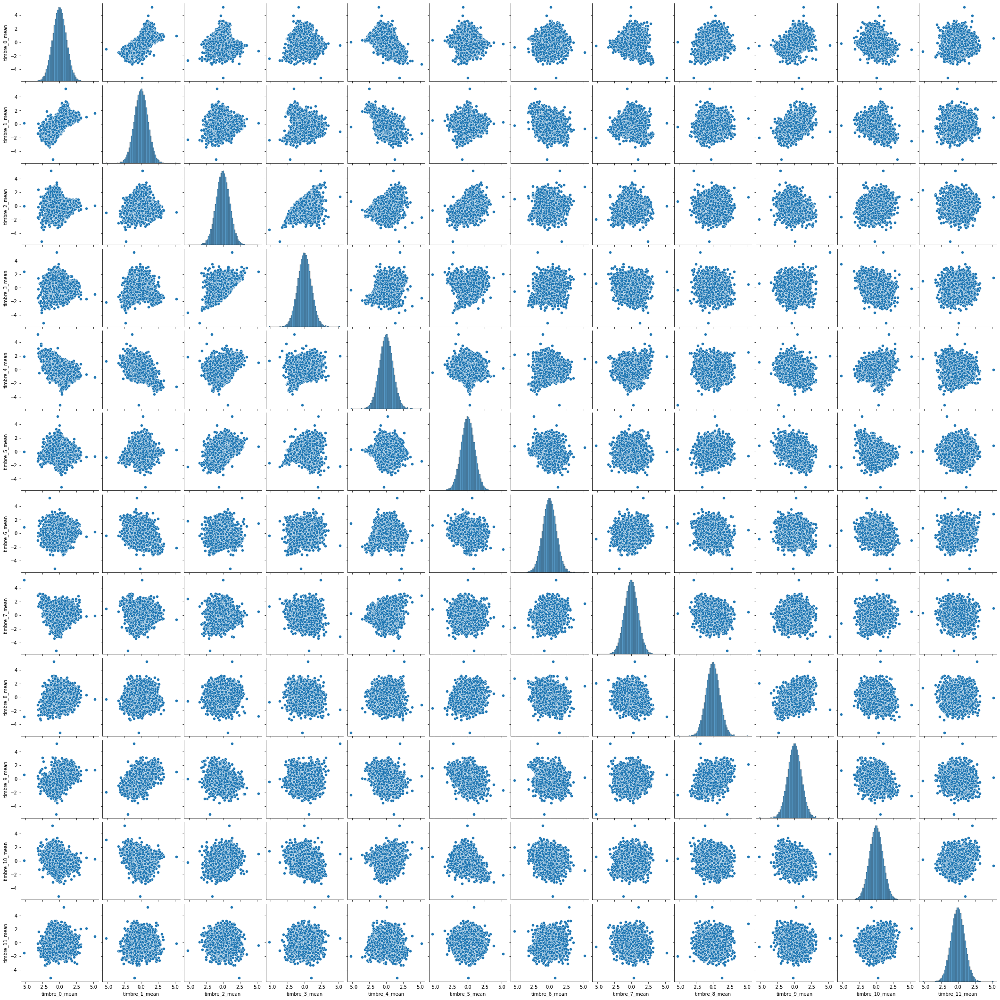

In [ ]:
# Normalizamos por min-max
MMS = MinMaxScaler()
df_timbres_mean_norm         = MMS.fit_transform(df_timbres_mean) 
df_timbres_mean_norm         = pd.DataFrame(df_timbres_mean_norm)
df_timbres_mean_norm.columns = ['timbre_0_mean','timbre_1_mean','timbre_2_mean','timbre_3_mean','timbre_4_mean','timbre_5_mean','timbre_6_mean','timbre_7_mean','timbre_8_mean','timbre_9_mean','timbre_10_mean','timbre_11_mean']

# Transformamos por Cuantiles
df_timbres_mean_norm_QT1         = quantile_transform(df_timbres_mean_norm, n_quantiles=1000, random_state=0, copy=True,output_distribution='normal')
df_timbres_mean_norm_QT1         = pd.DataFrame(df_timbres_mean_norm_QT1 )
df_timbres_mean_norm_QT1.columns = ['timbre_0_mean','timbre_1_mean','timbre_2_mean','timbre_3_mean','timbre_4_mean','timbre_5_mean','timbre_6_mean','timbre_7_mean','timbre_8_mean','timbre_9_mean','timbre_10_mean','timbre_11_mean']

# Verificamos como quedó el grafico de pares con las variables normalizadas y estandarizadas 
sns.pairplot(df_timbres_mean_norm_QT1)

### Desvíos de los Timbres

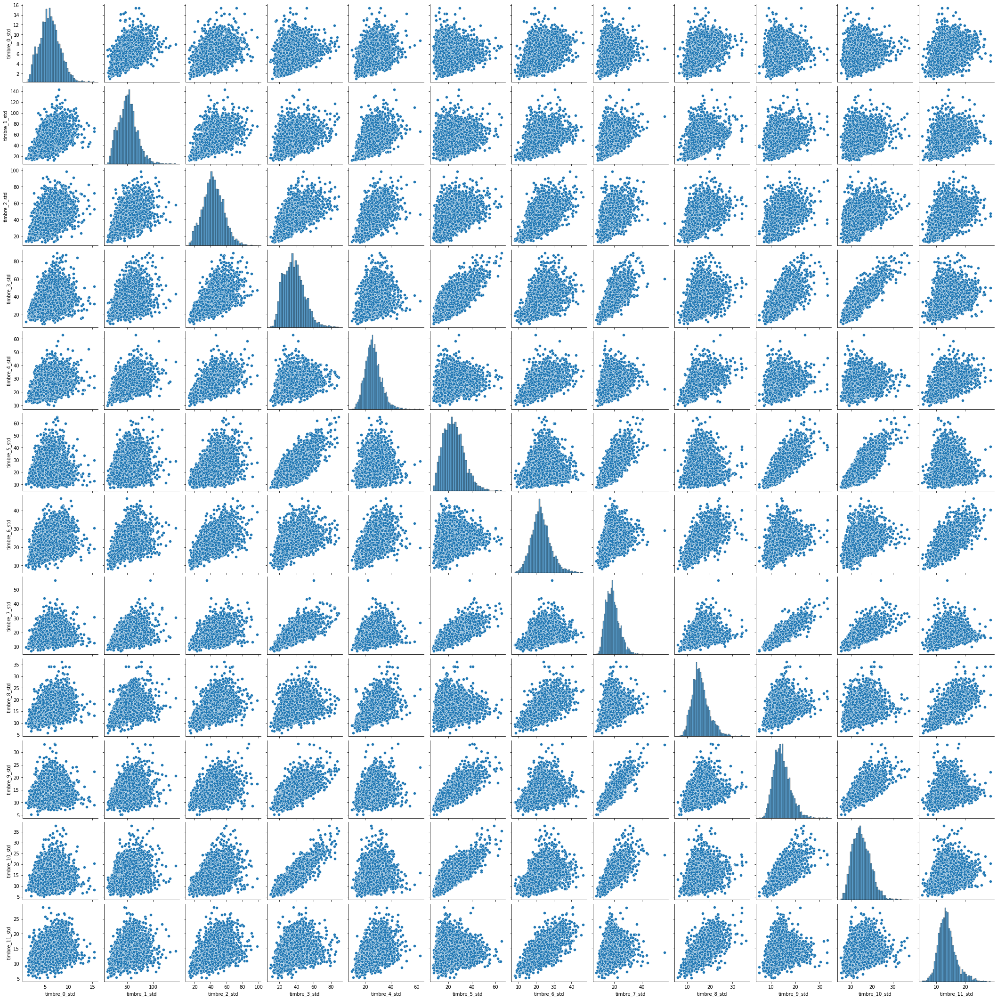

In [ ]:
# Hacemos un pairplot para los desvios de Timbres
df_timbres_std = df_full[['timbre_0_std','timbre_1_std','timbre_2_std','timbre_3_std','timbre_4_std','timbre_5_std','timbre_6_std','timbre_7_std','timbre_8_std','timbre_9_std','timbre_10_std','timbre_11_std']]
sns.pairplot(df_timbres_std)

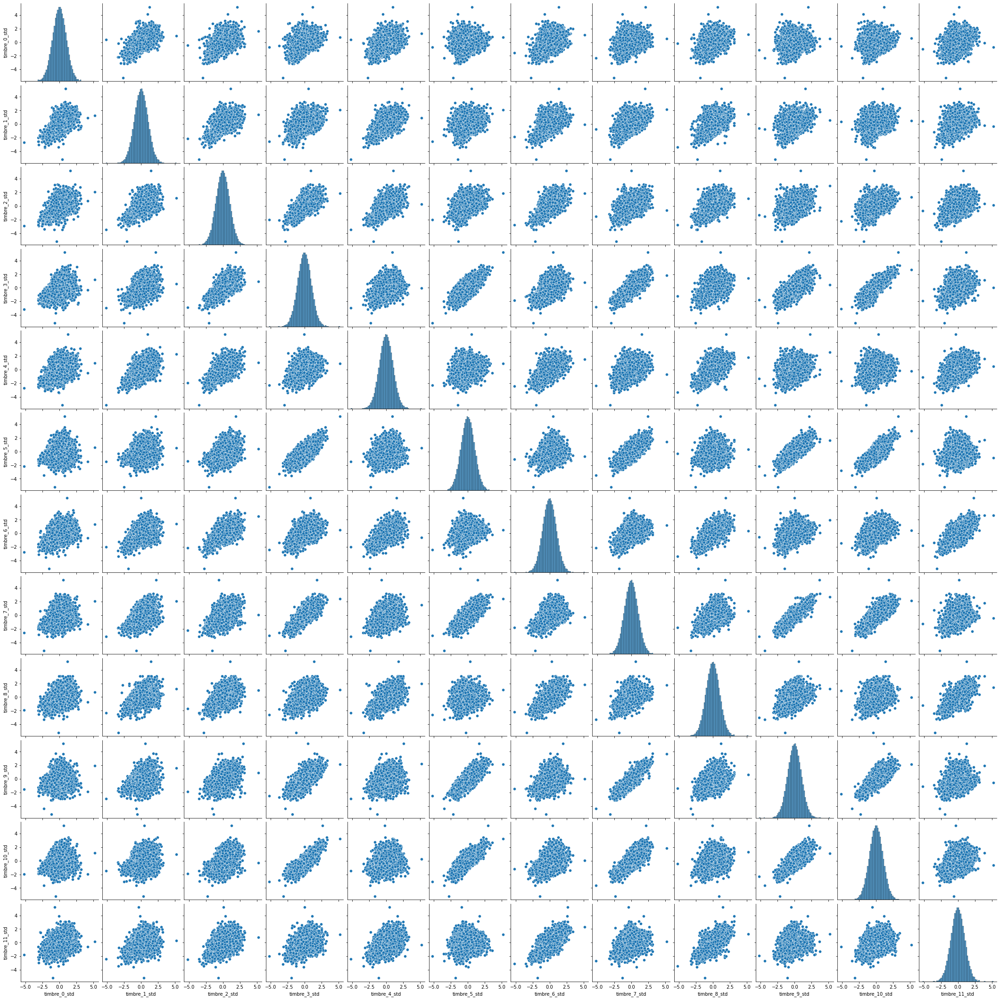

In [ ]:
# Normalizamos por min-max
MMS = MinMaxScaler()
df_timbres_std_norm         = MMS.fit_transform(df_timbres_std) 
df_timbres_std_norm         = pd.DataFrame(df_timbres_std_norm)
df_timbres_std_norm.columns = ['timbre_0_std','timbre_1_std','timbre_2_std','timbre_3_std','timbre_4_std','timbre_5_std','timbre_6_std','timbre_7_std','timbre_8_std','timbre_9_std','timbre_10_std','timbre_11_std']

# Transformamos por Cuantiles
df_timbres_std_norm_QT1         = quantile_transform(df_timbres_std_norm, n_quantiles=1000, random_state=0, copy=True,output_distribution='normal')
df_timbres_std_norm_QT1         = pd.DataFrame(df_timbres_std_norm_QT1 )
df_timbres_std_norm_QT1.columns = ['timbre_0_std','timbre_1_std','timbre_2_std','timbre_3_std','timbre_4_std','timbre_5_std','timbre_6_std','timbre_7_std','timbre_8_std','timbre_9_std','timbre_10_std','timbre_11_std']

# Verificamos como quedó el grafico de pares con las variables normalizadas y estandarizadas 
sns.pairplot(df_timbres_std_norm_QT1)

La transformación por Cuantiles de la media y STD de los pitches y los timbres arroja distribuciones muy semejantes a la Normal Standard para todas las variables.

### Guardamos un backup de todos los datos procesados en el Drive

In [ ]:
df_pitches_mean = df_full[['pitch_0_mean','pitch_1_mean','pitch_2_mean','pitch_3_mean','pitch_4_mean','pitch_5_mean','pitch_6_mean','pitch_7_mean','pitch_8_mean','pitch_9_mean','pitch_10_mean','pitch_11_mean']]
df_pitches_std = df_full[['pitch_0_std','pitch_1_std','pitch_2_std','pitch_3_std','pitch_4_std','pitch_5_std','pitch_6_std','pitch_7_std','pitch_8_std','pitch_9_std','pitch_10_std','pitch_11_std']]
df_timbres_mean = df_full[['timbre_0_mean','timbre_1_mean','timbre_2_mean','timbre_3_mean','timbre_4_mean','timbre_5_mean','timbre_6_mean','timbre_7_mean','timbre_8_mean','timbre_9_mean','timbre_10_mean','timbre_11_mean']]
df_timbres_std = df_full[['timbre_0_std','timbre_1_std','timbre_2_std','timbre_3_std','timbre_4_std','timbre_5_std','timbre_6_std','timbre_7_std','timbre_8_std','timbre_9_std','timbre_10_std','timbre_11_std']]


In [ ]:
## Armamos un nuevo dataframe final con todos los dato normalizados y estandarizados
df_pitches_summary   = pd.merge(df_pitches_mean_norm_QT1, df_pitches_std_norm_QT1, on='id')
df_timbres_summary   = pd.merge(df_timbres_mean_norm_QT1, df_timbres_std_norm_QT1, on='id')
df_aa_summary2       = pd.merge(df_pitches_summary, df_timbres_summary, on='id')
df_aa_summary2['id'] = df_full['id']

df_full2 = pd.merge(df_tracks_01, X_features_final, on='id')
df_full2 = pd.merge(df_full2, df_aa_summary2, on='id')  

# Guardamos el dataset full2 en el Drive
df_full2.to_pickle('./drive/My Drive/DMCyT/TP01/df_full2.pkl')

In [ ]:
df_full.shape

(4082, 65)

## Outliers
Generamos los boxplots para todas las variables transformadas

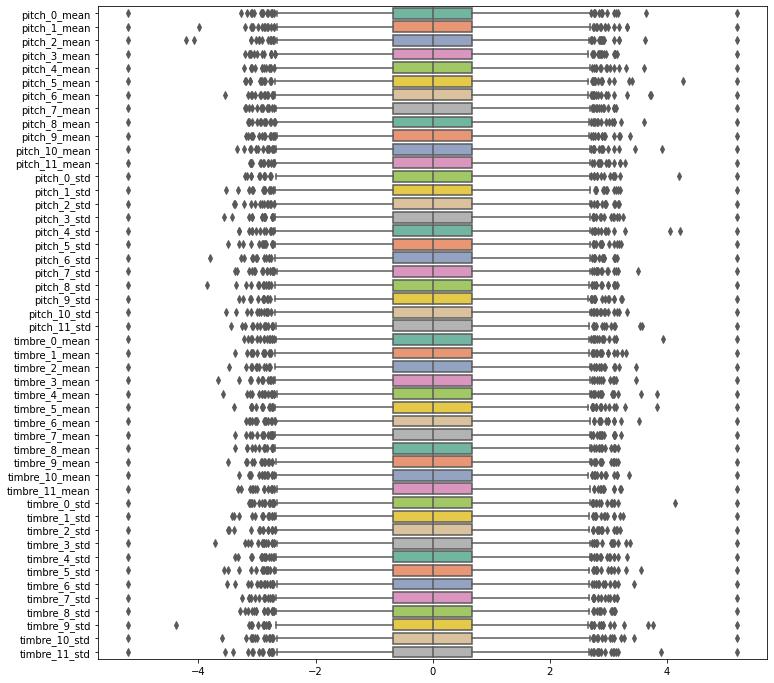

In [ ]:
# Calculamos Outliers
fig=plt.figure(figsize=(12,12))
ax=sns.boxplot(data=df_aa_summary2, orient="h", palette="Set2")

Al visualizar los Boxplots de las variables transformadas, se observa en todos los casos Outliers severos por izquierda y derecha. Como propuesta de eliminación de Outliers, y a partir de la observación gráfica de los Boxplots, creemos que el criterio más adecuado sería el de 3*IQR.

# Conclusiones

Este primer análisis exploratorio de los tres conjuntos de datos ( tracks, audio_features, y audio_analysis) nos permitió observar y transformar los descriptores o atributos (features) de alto nivel y bajo nivel de las pistas que obtuvimos de la API de Spotify. La preparación de los datos es clave para luego continuar con el  objetivo final de utilizar distintos algoritmos de clustering y encontrar agrupaciones/relaciones entre los tracks o genéros según estos atributos.
